In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
from pandas.plotting import autocorrelation_plot

import matplotlib.pyplot as plt
import seaborn as sns

import os, gc
import pickle
import datetime, time
from tqdm import tqdm_notebook as tqdm


from sklearn import preprocessing

%matplotlib inline

In [2]:
path = '/Users/kanoumotoharu/Downloads/m5-forecasting-accuracy/'
#path = '/Users/abcdm/Downloads/m5-forecasting-accuracy/'
#path = '../input/m5-forecasting-accuracy/'

In [3]:
%%time
train_df = pd.read_csv(path+'sales_train_validation.csv')
calendar_df = pd.read_csv(path+'calendar.csv')
sell_prices_df = pd.read_csv(path+'sell_prices.csv')
sample_submission_df = pd.read_csv(path+'sample_submission.csv')

CPU times: user 14.1 s, sys: 1.57 s, total: 15.7 s
Wall time: 16.3 s


In [4]:
sell_prices_df['id'] = sell_prices_df['item_id'].astype('str')+'_'+sell_prices_df['store_id']+'_validation'
sell_prices_data = sell_prices_df[sell_prices_df.wm_yr_wk.isin(calendar_df.wm_yr_wk.unique())]
sell_prices_data.reset_index(drop=True, inplace=True)
tmp = sell_prices_data.groupby(['id'])[['wm_yr_wk', 'sell_price']].apply(lambda x: x.set_index('wm_yr_wk')['sell_price'].to_dict()).to_dict()
d = calendar_df.d
wm_yr_wk = calendar_df.wm_yr_wk
price_data = {}
for col in tqdm(train_df.id.unique()):
    price_data[col] = wm_yr_wk.map(tmp[col])
price_data = pd.DataFrame(price_data)
price_data.index = d
is_sell = price_data.notnull().astype(float).T
price_data = price_data.fillna(0)    

In [5]:
d_cols = train_df.columns[train_df.columns.str.startswith('d_')].values.tolist()

In [6]:
calendar_df['date']=pd.to_datetime(calendar_df.date)

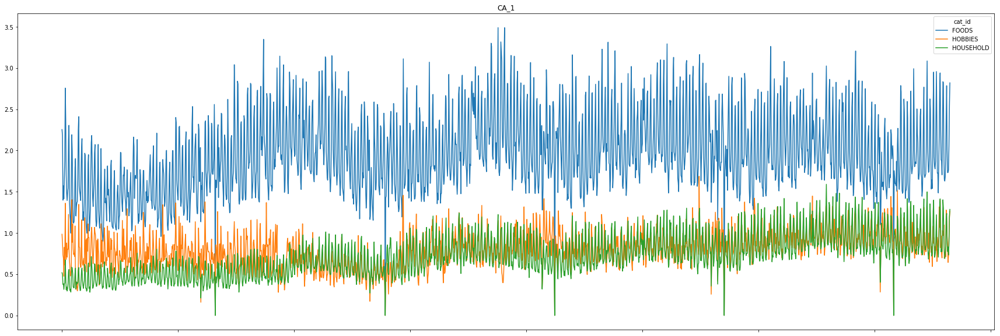

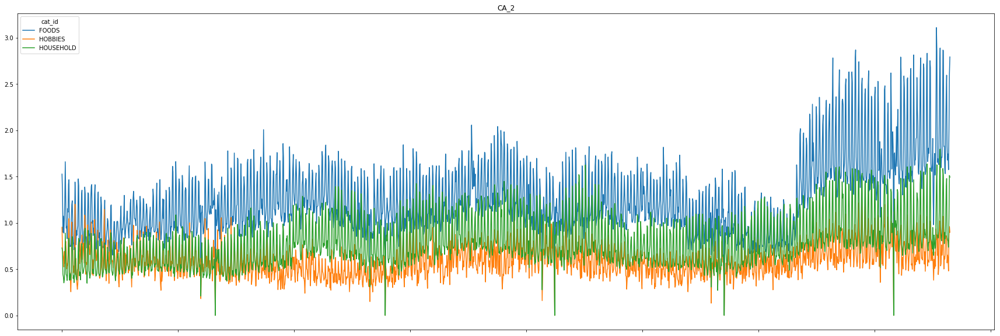

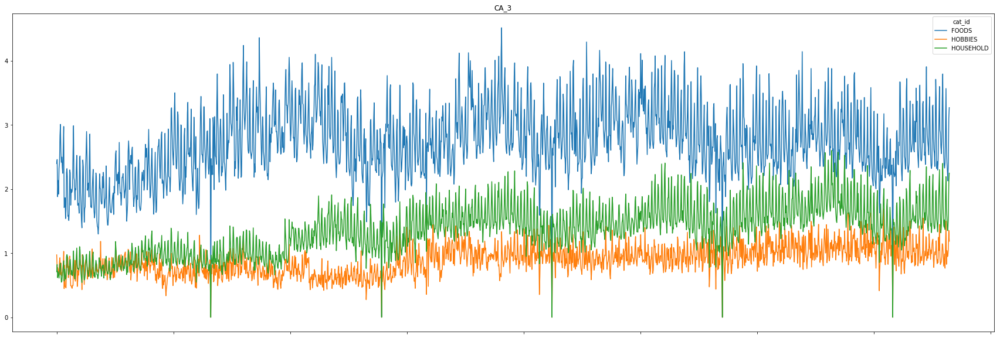

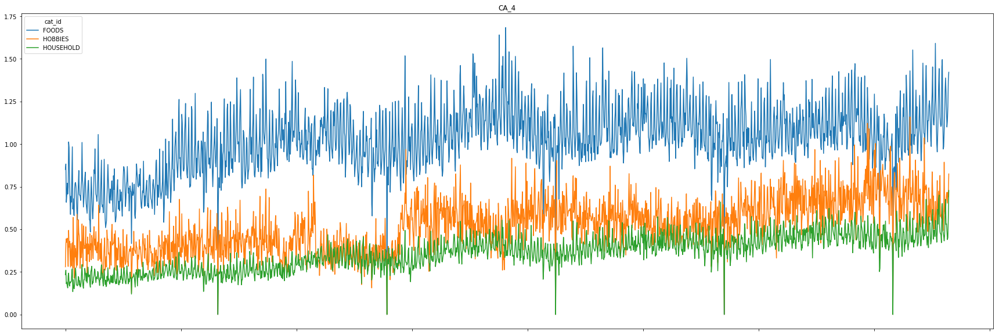

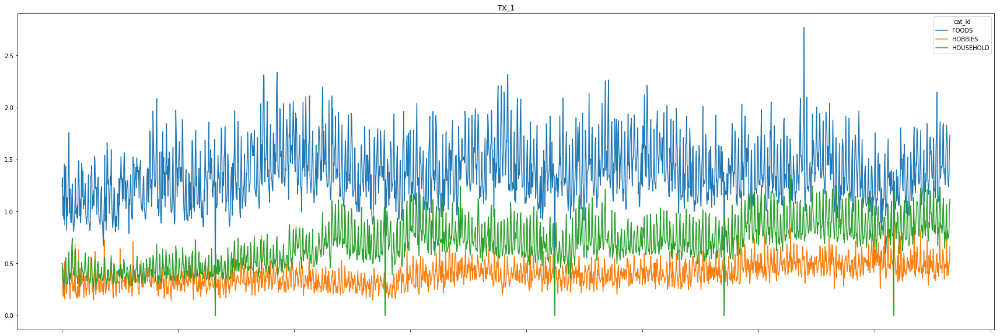

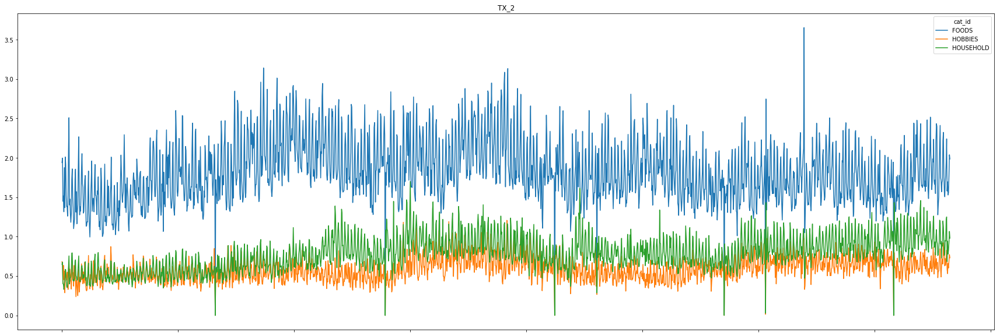

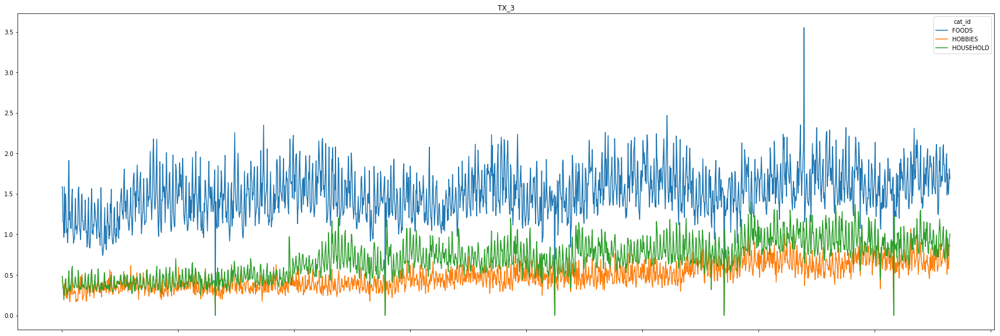

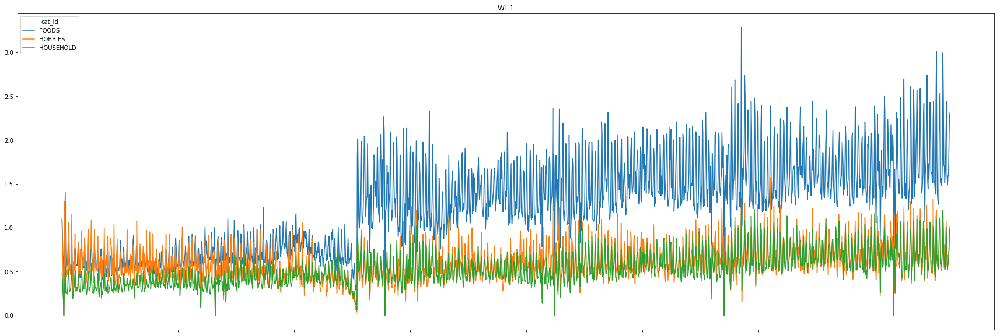

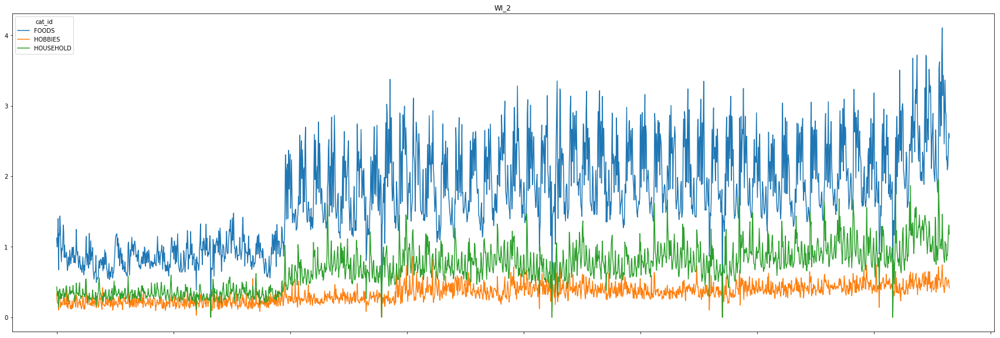

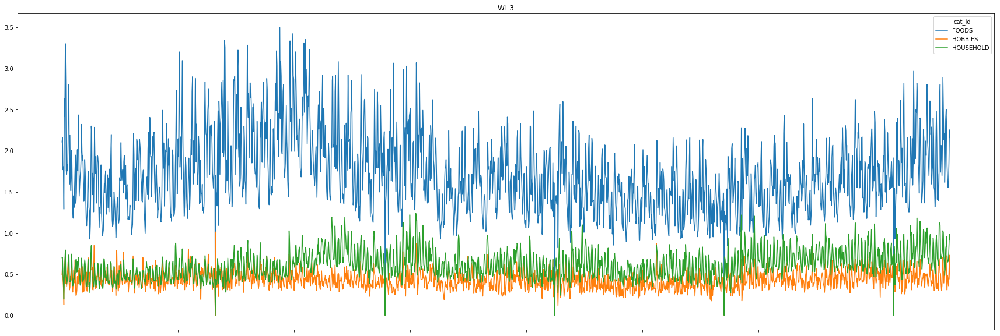

In [24]:
for store in train_df.store_id.unique():
    tmp_df = train_df[train_df.store_id==store]
    tmp_df.groupby(['cat_id'])[d_cols].mean().T.plot(figsize=(30,10))
    plt.title(store)

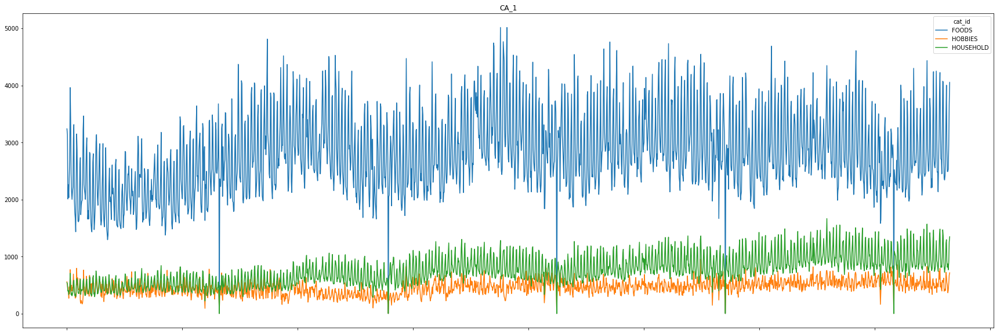

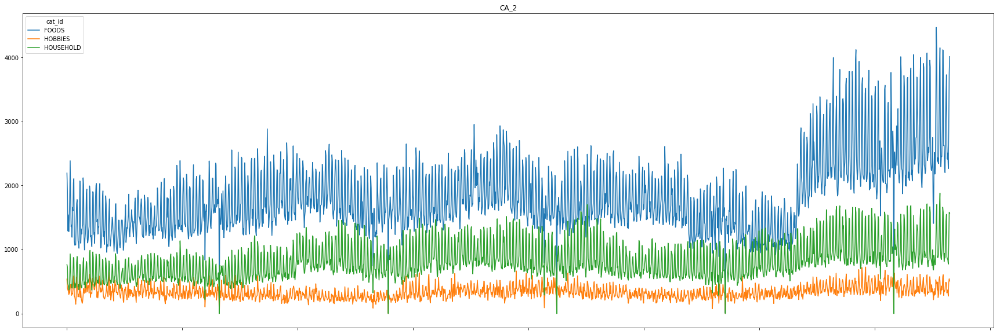

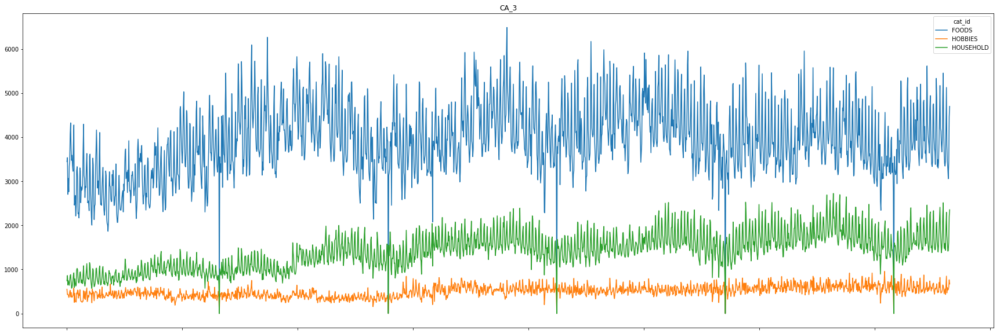

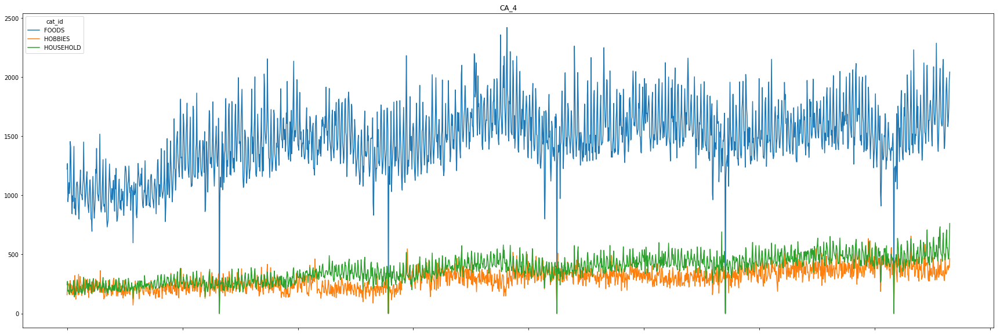

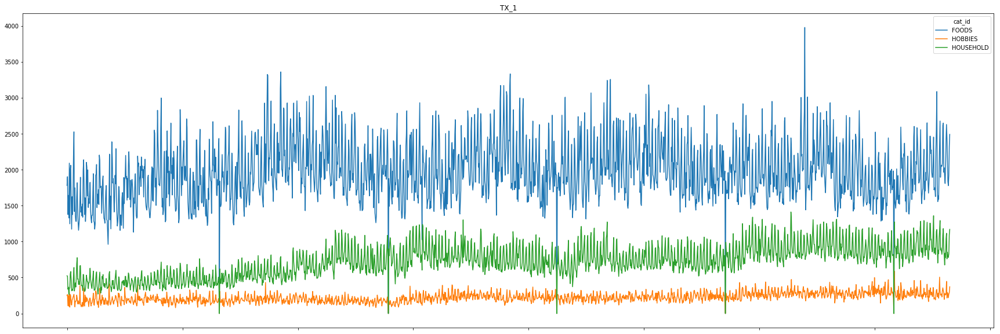

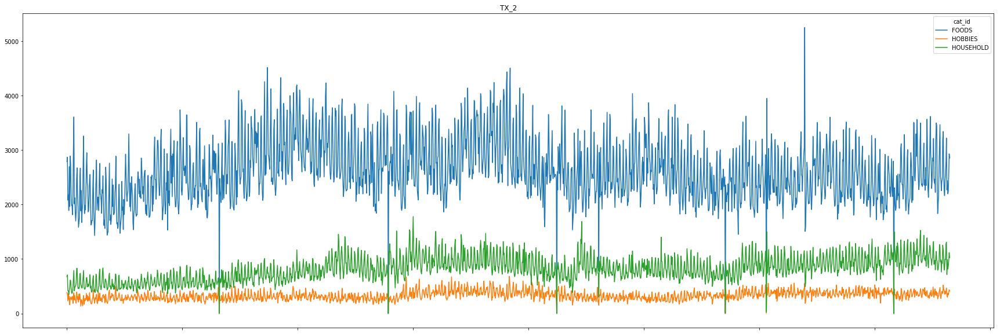

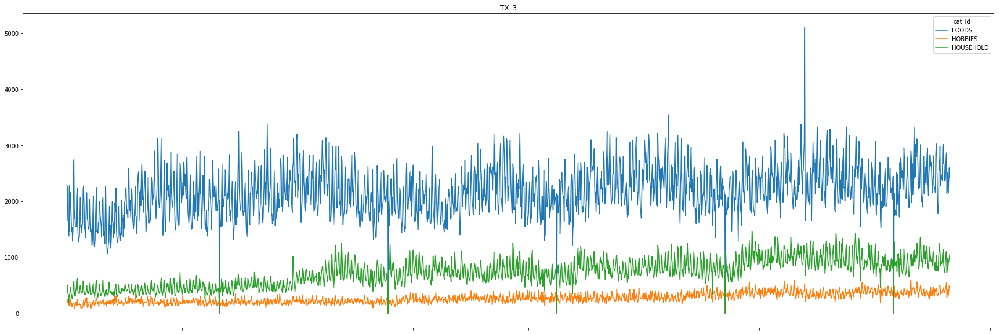

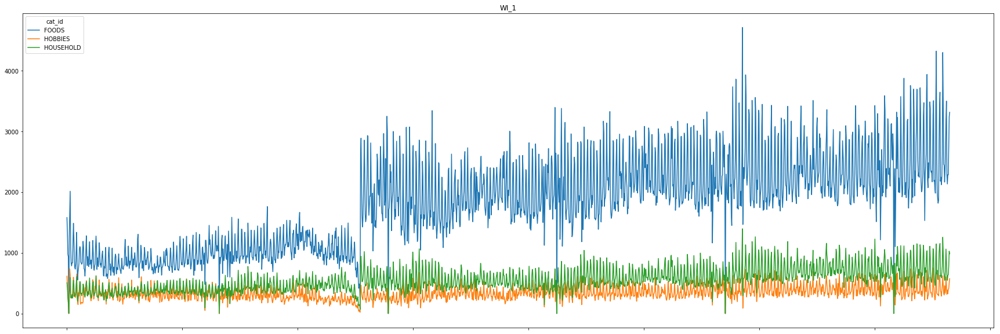

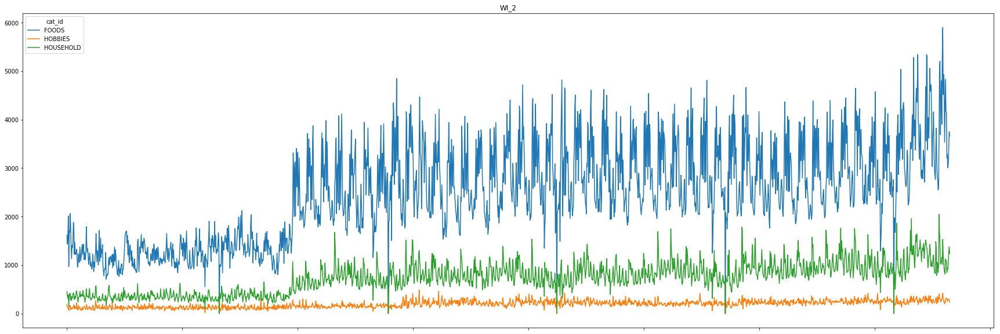

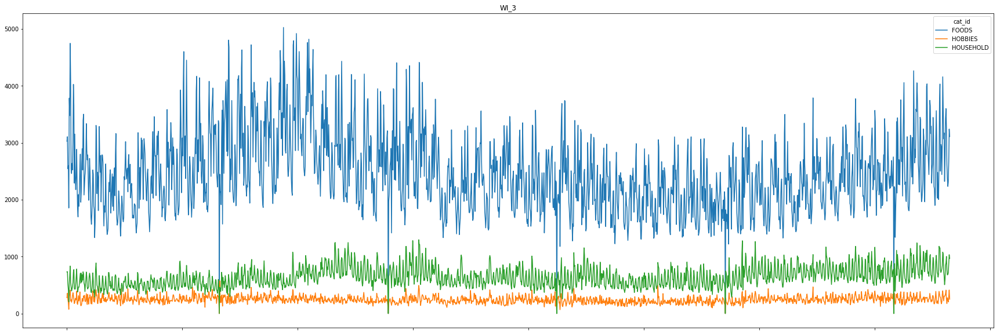

In [80]:
for store in train_df.store_id.unique():
    tmp_df = train_df[train_df.store_id==store]
    tmp_df.groupby(['cat_id'])[d_cols].sum().T.plot(figsize=(30,10))
    plt.title(store)

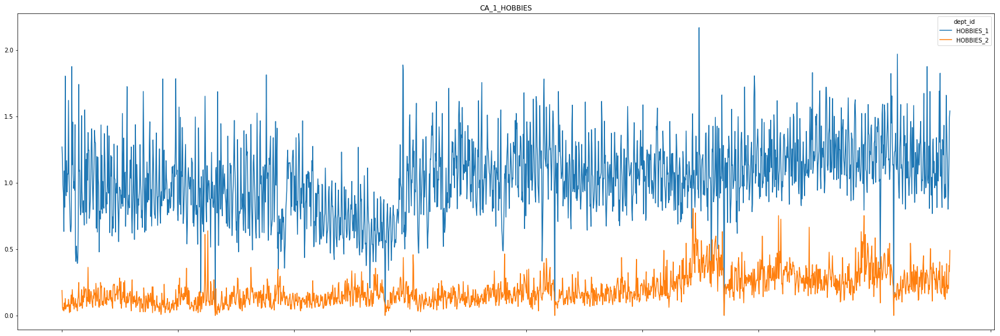

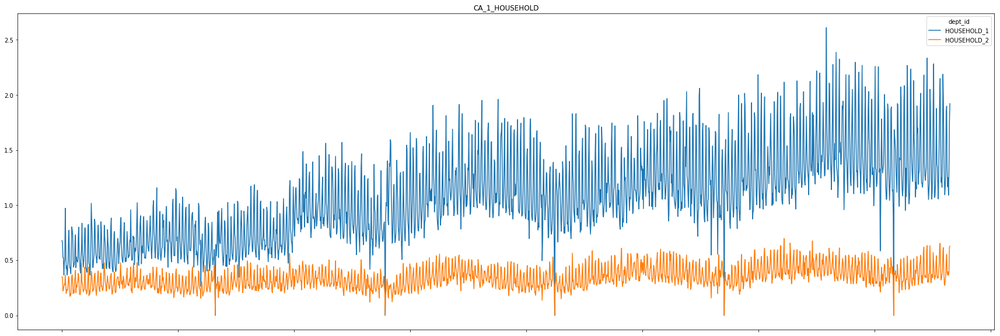

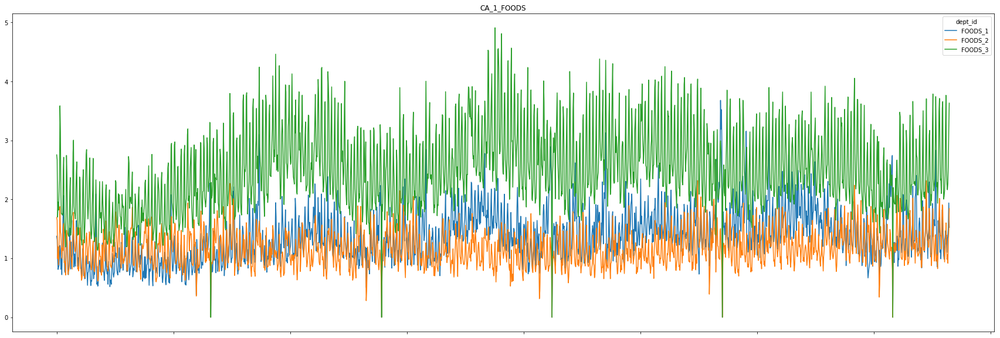

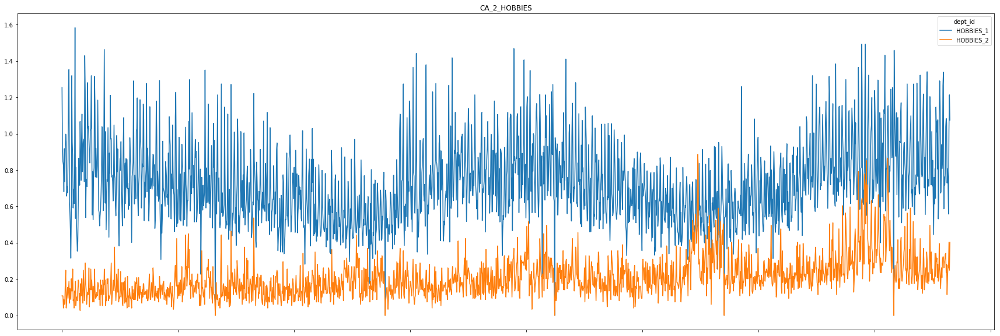

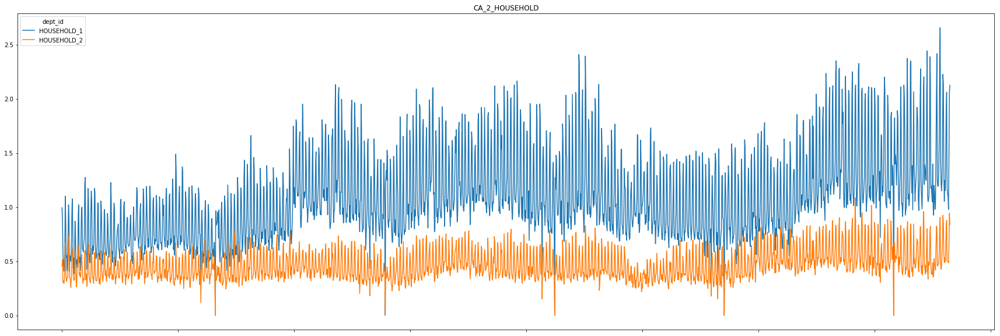

...

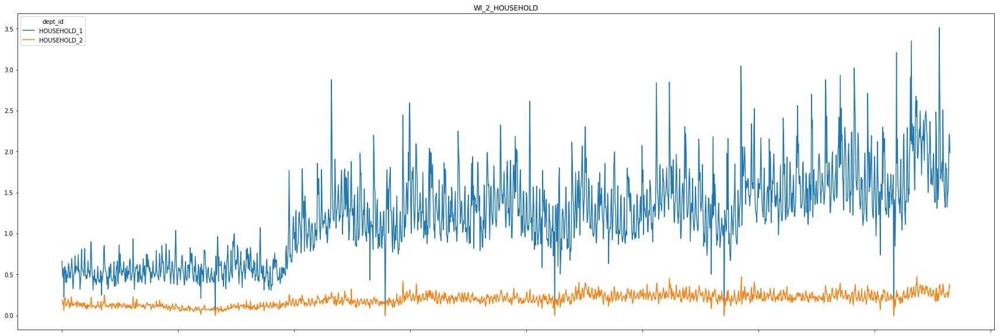

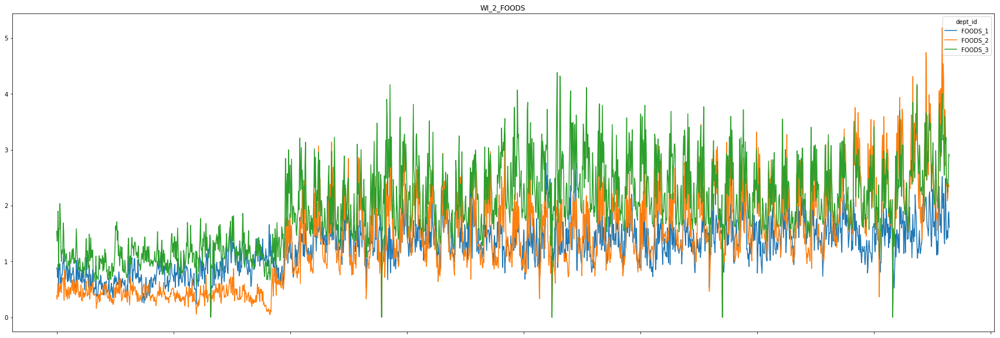

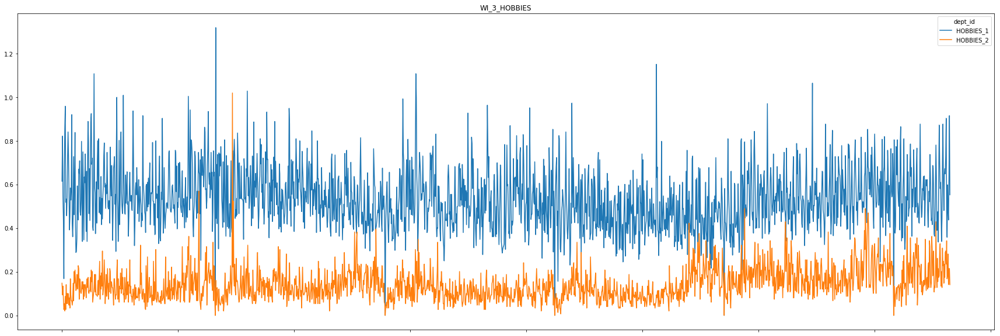

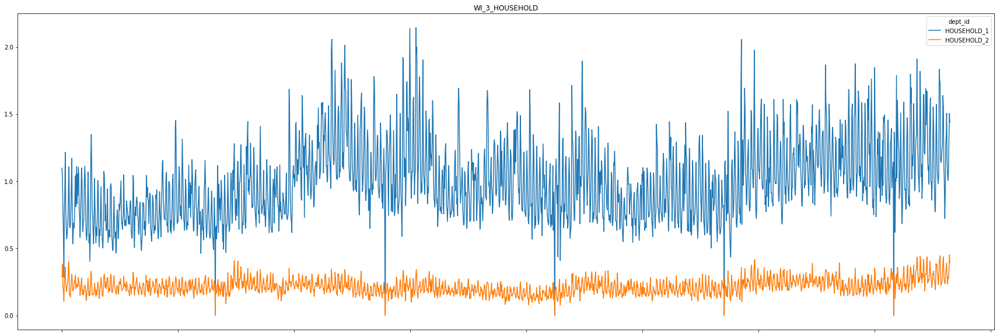

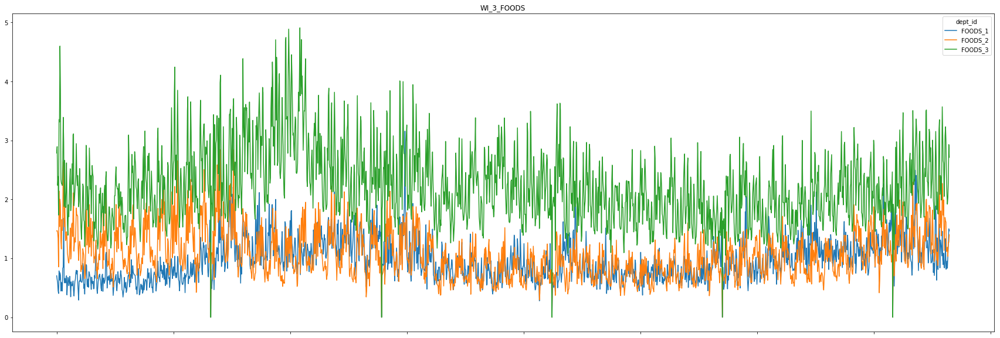

In [26]:
for store in train_df.store_id.unique():
    tmp_df = train_df[train_df.store_id==store]
    for cat_id in tmp_df.cat_id.unique():
        tmp_df2 = tmp_df[tmp_df.cat_id==cat_id]
        tmp_df2.groupby(['dept_id'])[d_cols].mean().T.plot(figsize=(30,10))
        plt.title(str(store+'_'+cat_id))

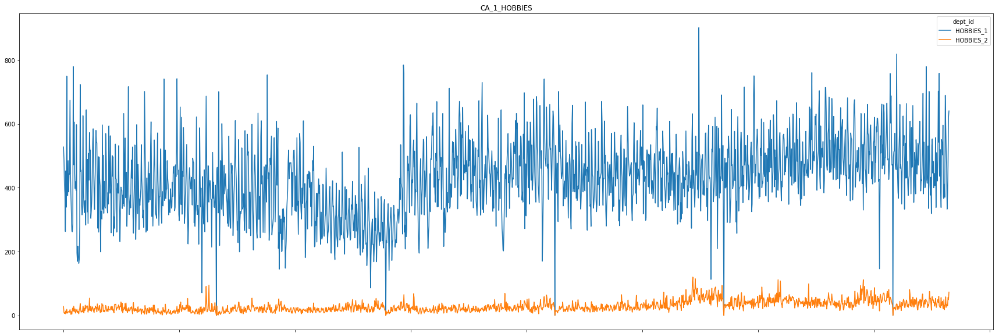

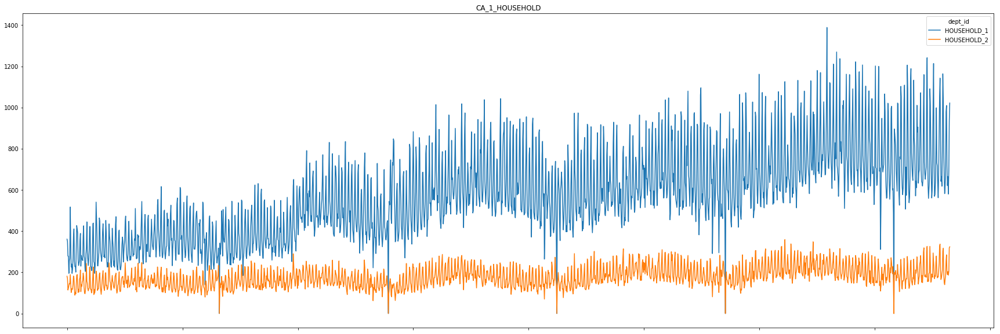

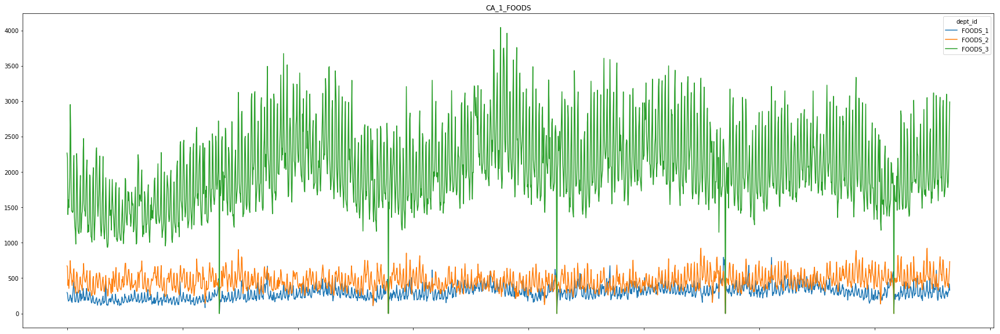

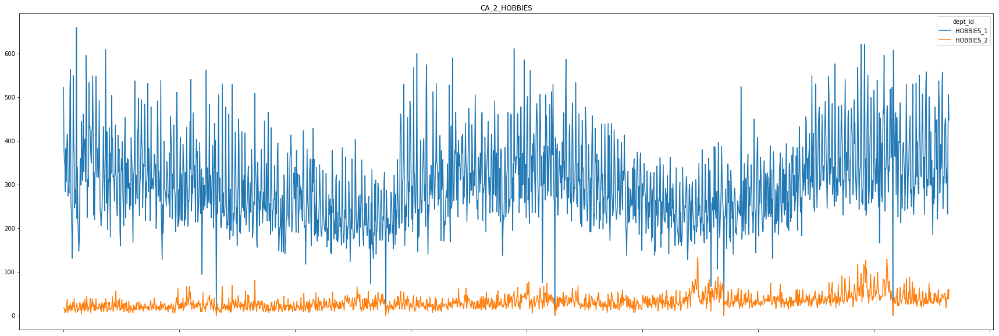

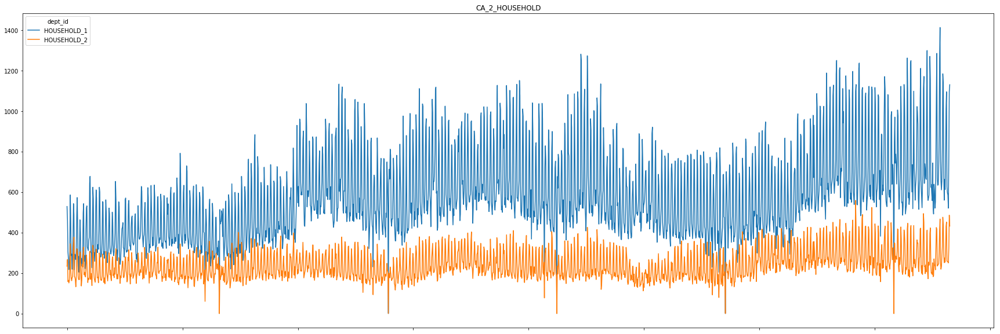

...

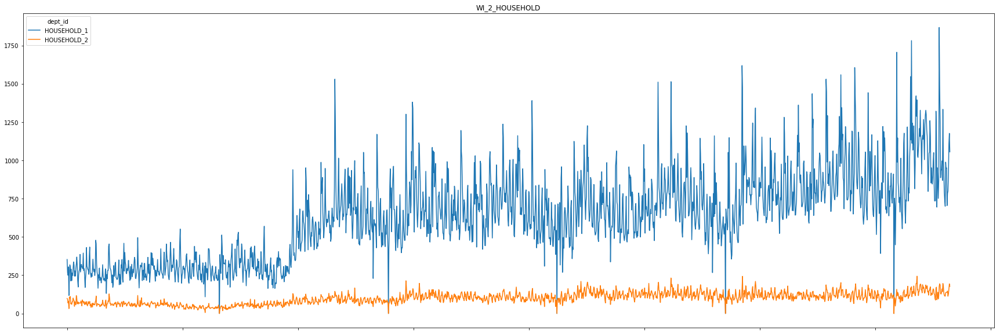

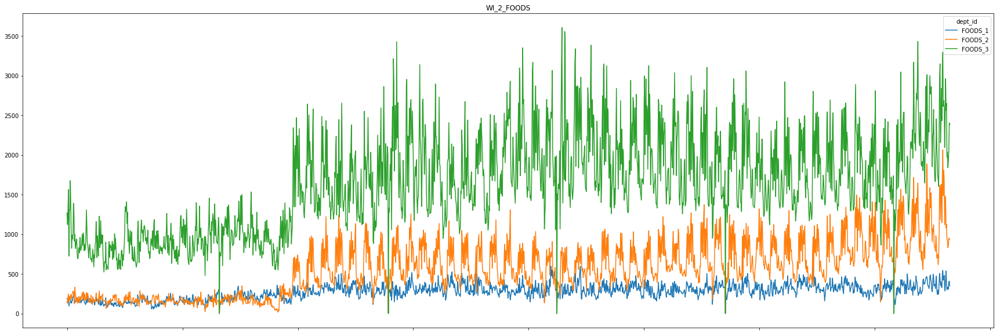

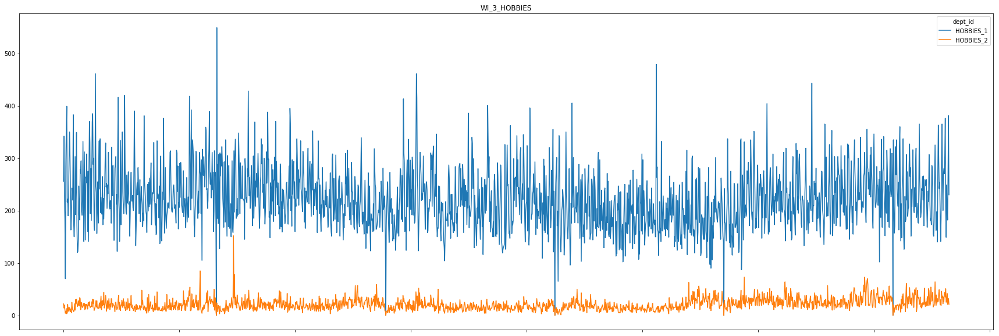

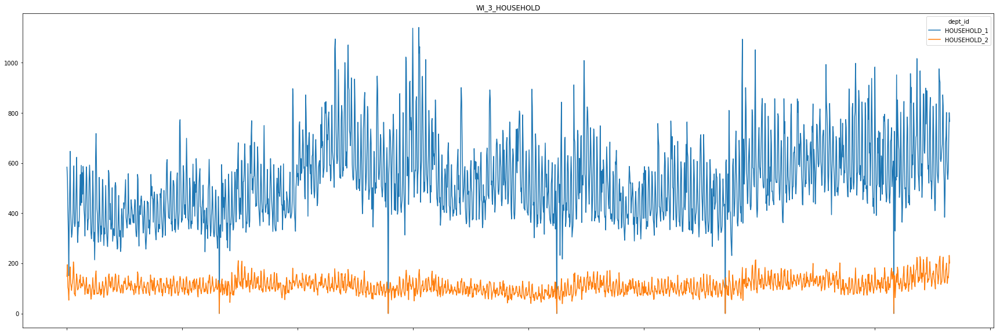

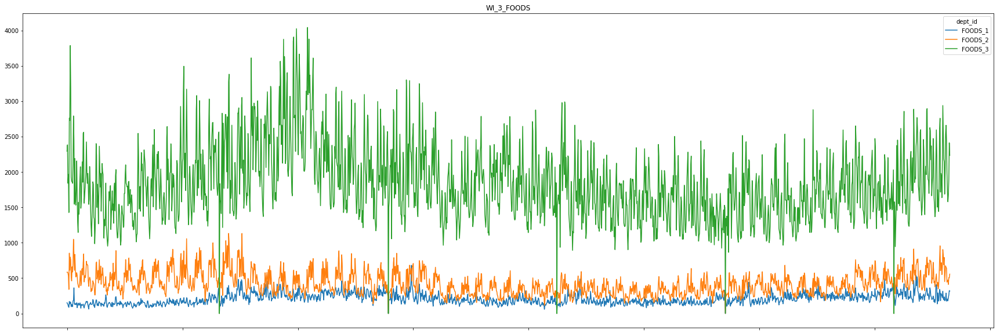

In [81]:
for store in train_df.store_id.unique():
    tmp_df = train_df[train_df.store_id==store]
    for cat_id in tmp_df.cat_id.unique():
        tmp_df2 = tmp_df[tmp_df.cat_id==cat_id]
        tmp_df2.groupby(['dept_id'])[d_cols].sum().T.plot(figsize=(30,10))
        plt.title(str(store+'_'+cat_id))

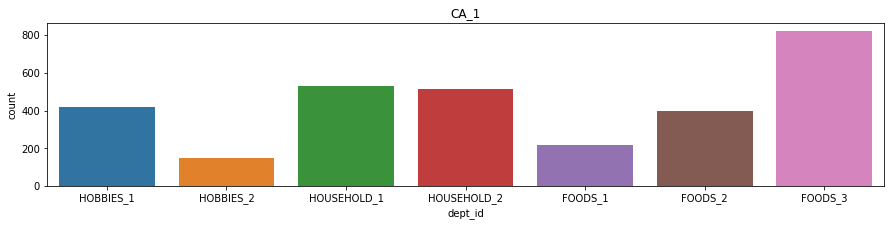

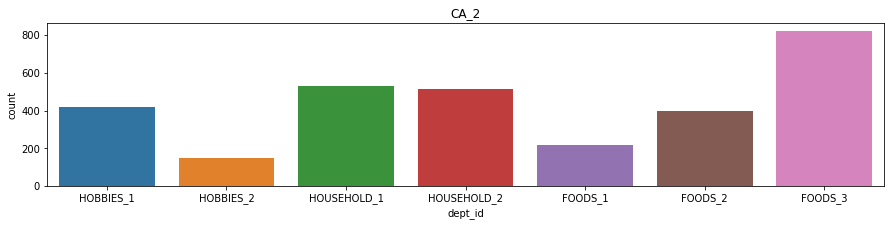

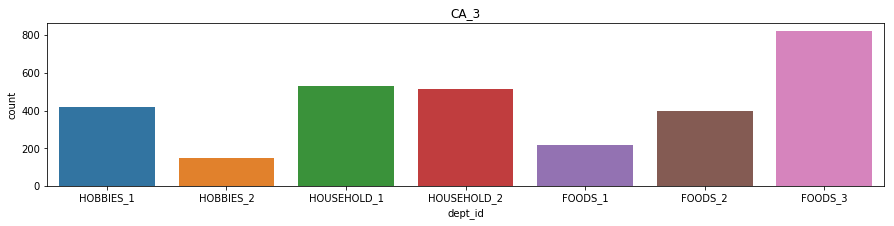

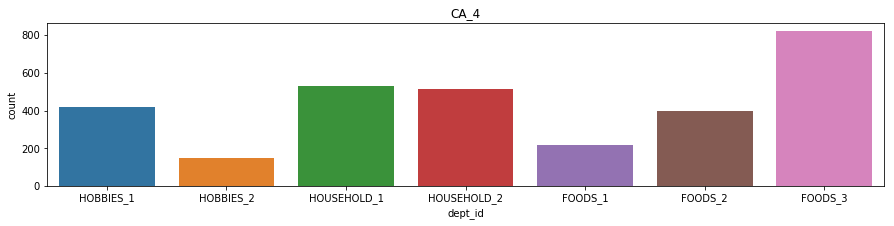

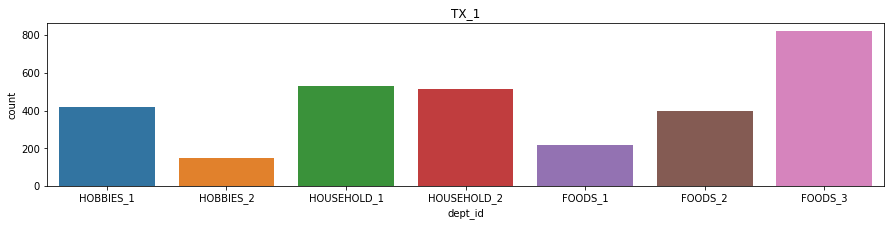

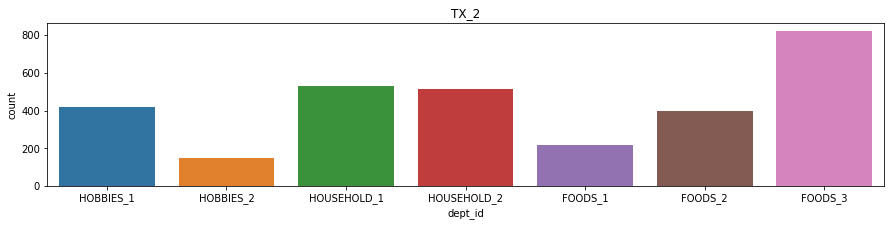

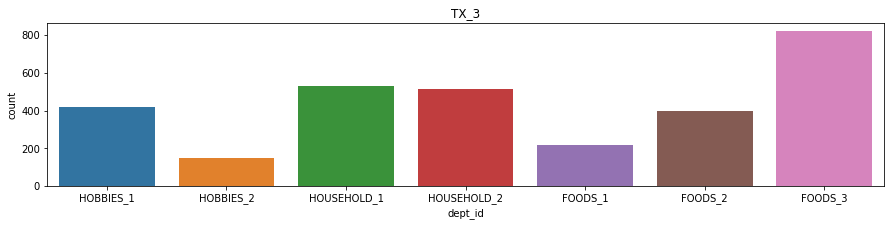

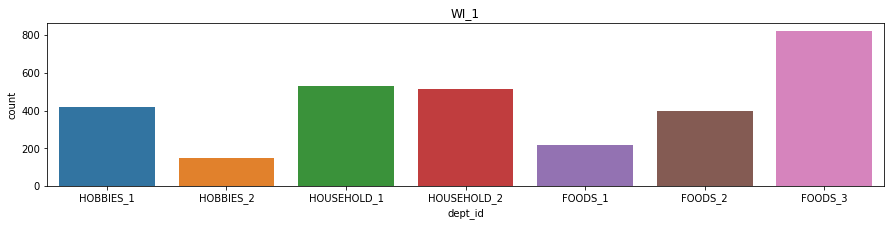

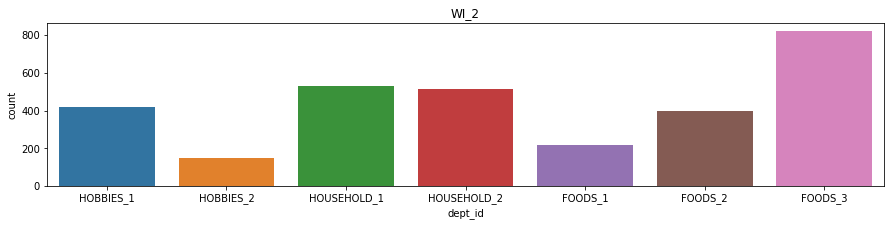

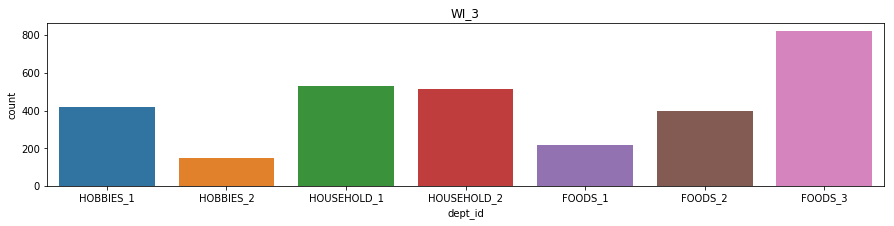

In [35]:
for store in train_df.store_id.unique():
    tmp_df = train_df[train_df.store_id==store]
    plt.figure(figsize=(15,3))
    sns.countplot(tmp_df.dept_id)
    plt.title(store)

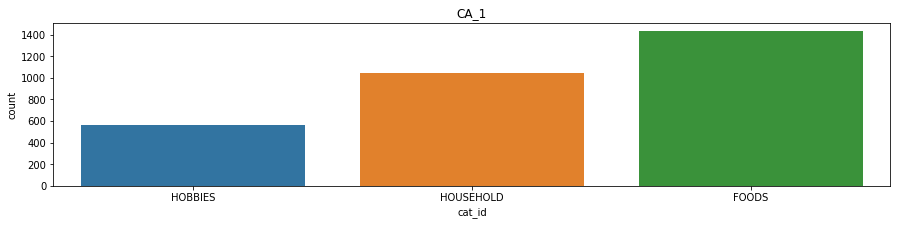

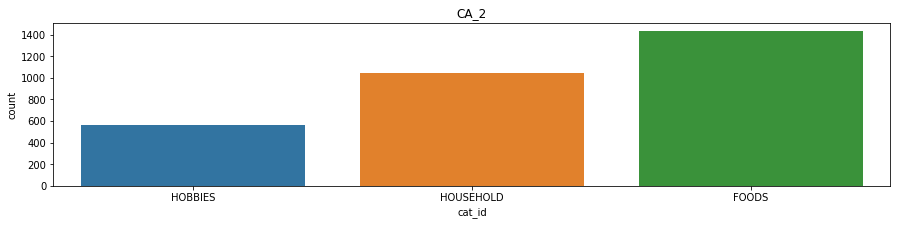

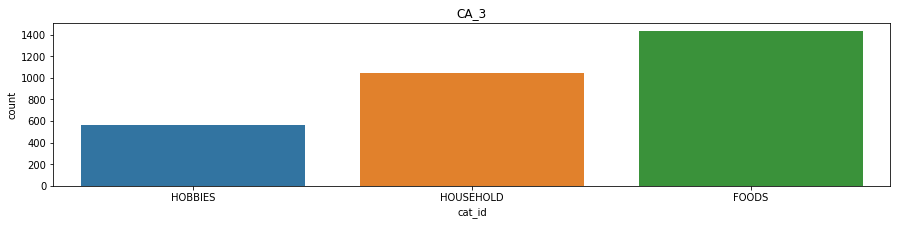

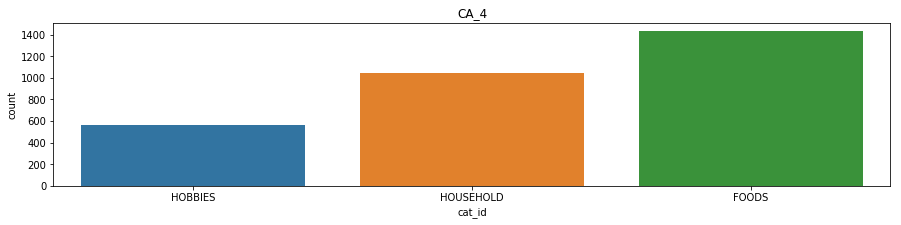

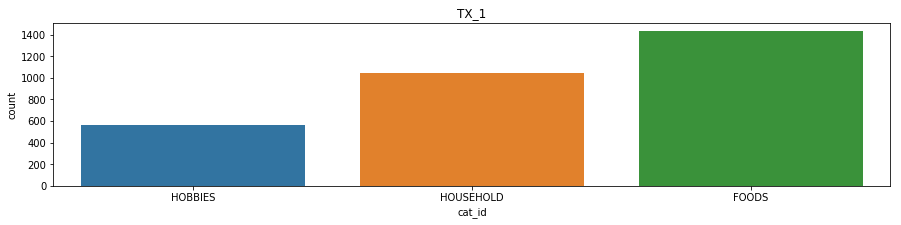

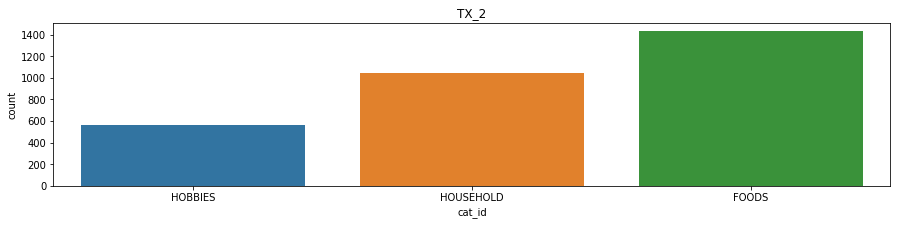

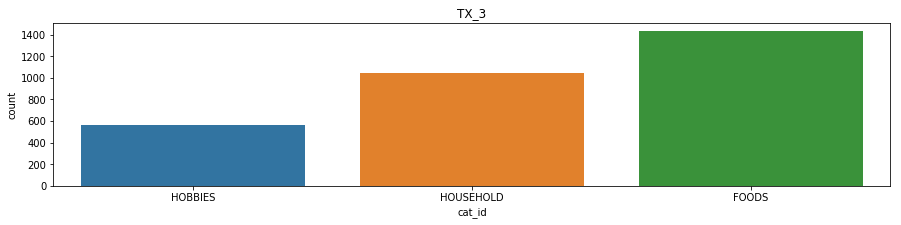

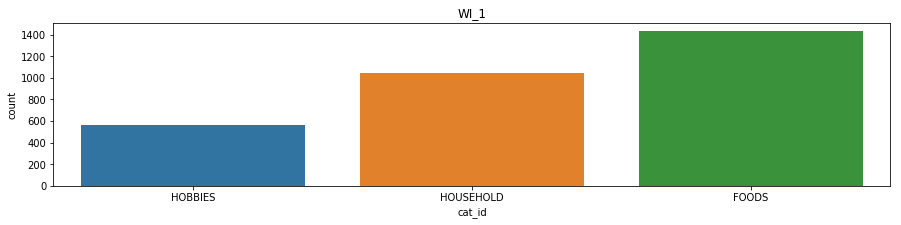

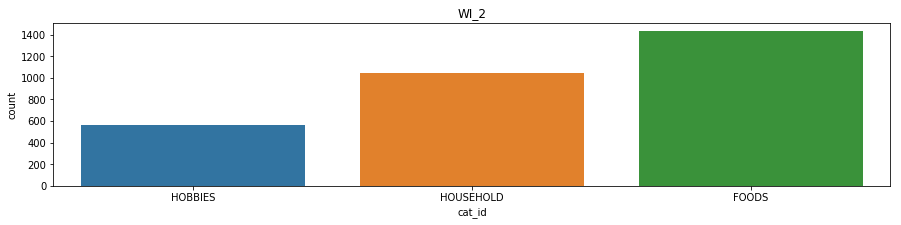

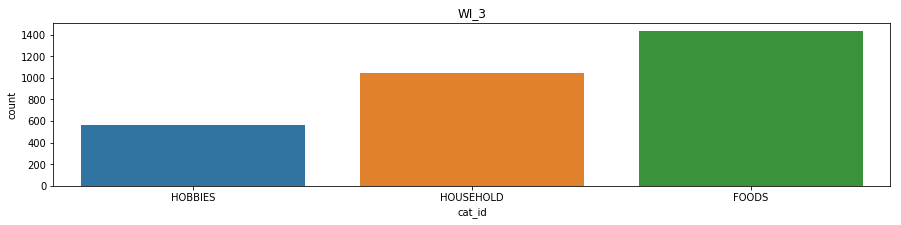

In [37]:
for store in train_df.store_id.unique():
    tmp_df = train_df[train_df.store_id==store]
    plt.figure(figsize=(15,3))
    sns.countplot(tmp_df.cat_id)
    plt.title(store)

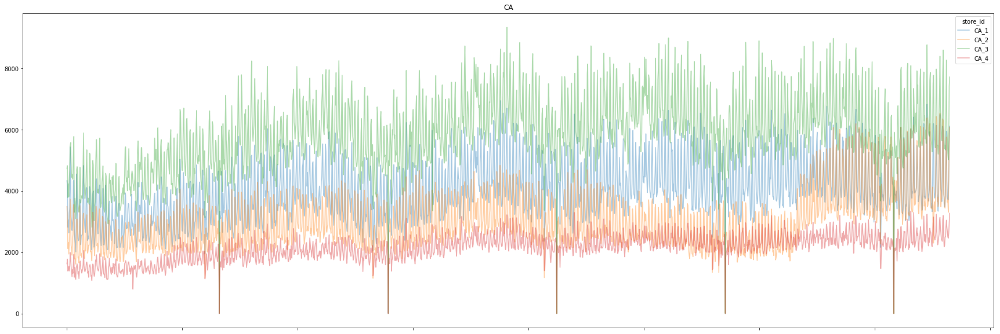

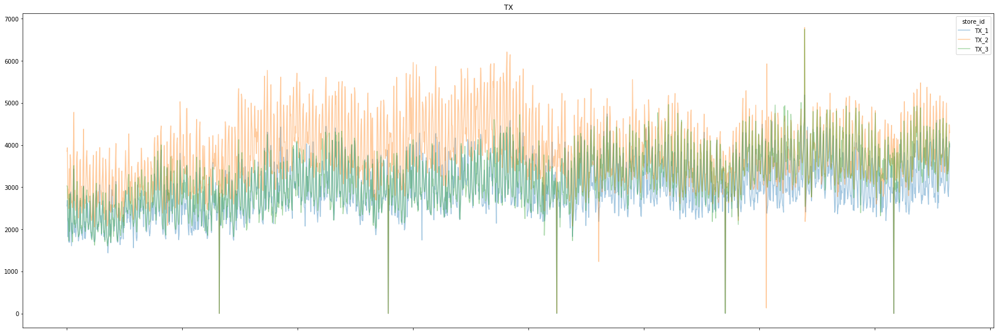

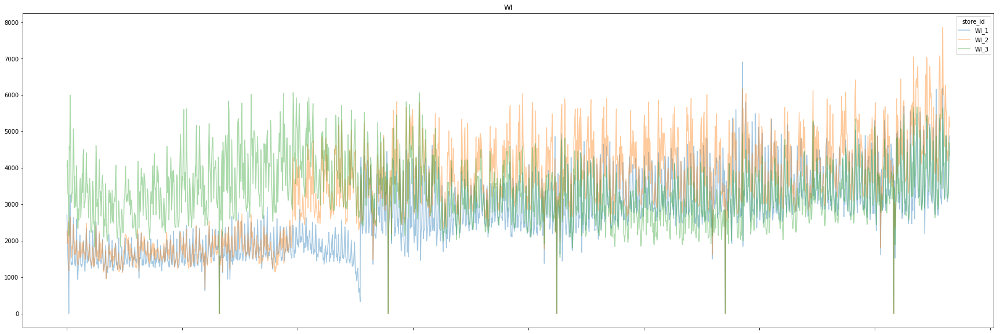

In [42]:
for state in train_df.state_id.unique():
    tmp_df = train_df[train_df.state_id==state]
    tmp_df.groupby(['store_id'])[d_cols].sum().T.plot(figsize=(30,10), alpha=0.4)
    plt.title(state)

In [55]:
train_df.columns[:8]

Index(['id', 'item_id', 'dept_id', 'cat_id', 'store_id', 'state_id', 'd_1',
       'd_2'],
      dtype='object')

In [105]:
is_sell.index=train_df.id
train_df.index=train_df.id

In [70]:
#is_sell.drop(columns=['id', 'item_id', 'dept_id', 'cat_id', 'store_id', 'state_id'], inplace=True)
#is_sell = is_sell.dropna()

In [106]:
is_sell = pd.concat([
    train_df[['id', 'item_id', 'dept_id', 'cat_id', 'store_id', 'state_id']], is_sell
], axis=1)

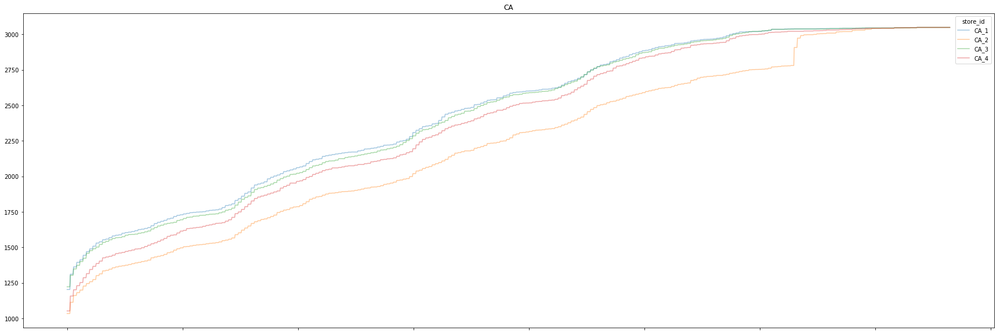

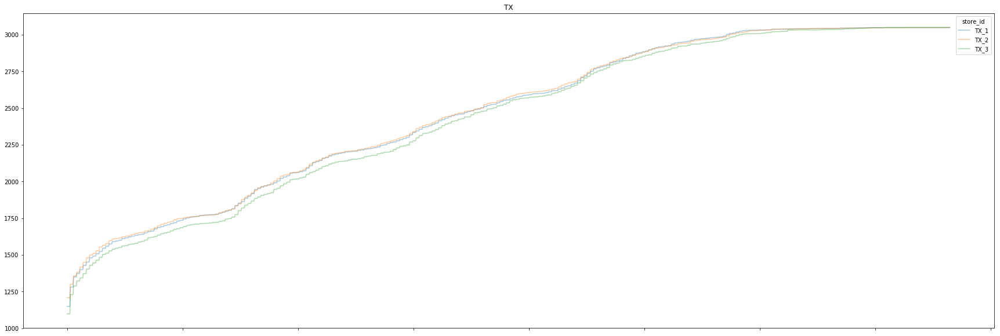

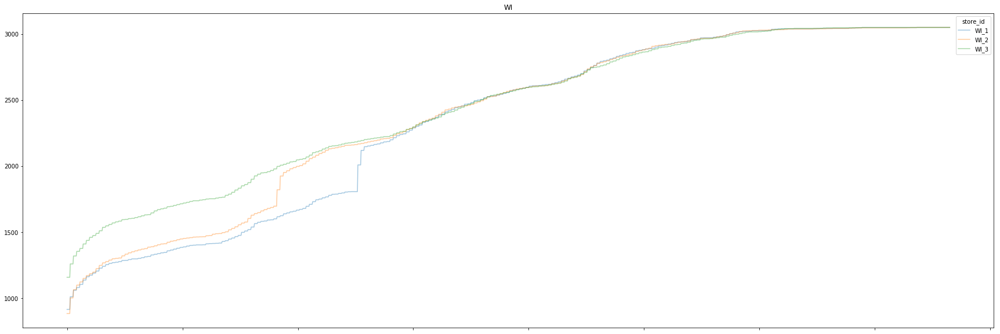

In [79]:
for state in train_df.state_id.unique():
    tmp_df = is_sell[is_sell.state_id==state]
    tmp_df.groupby(['store_id'])[d_cols].sum().T.plot(figsize=(30,10), alpha=0.4)
    plt.title(state)

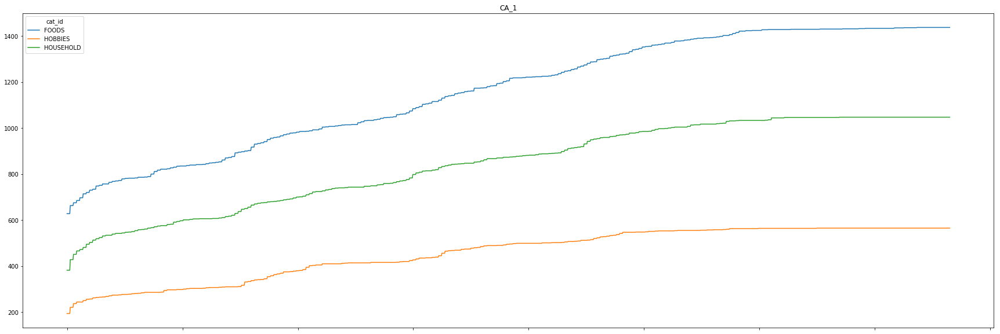

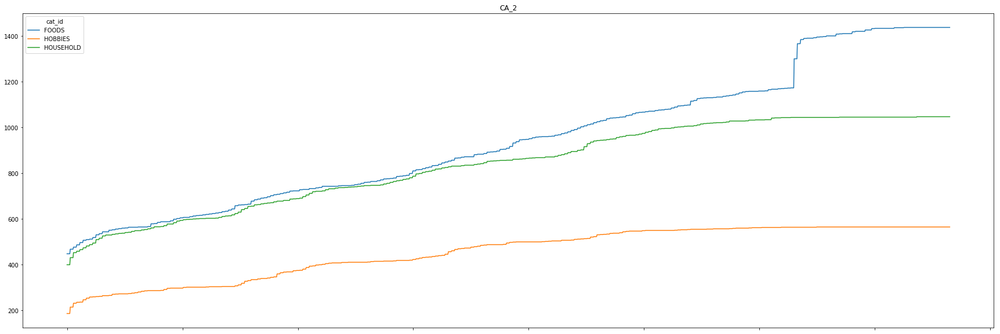

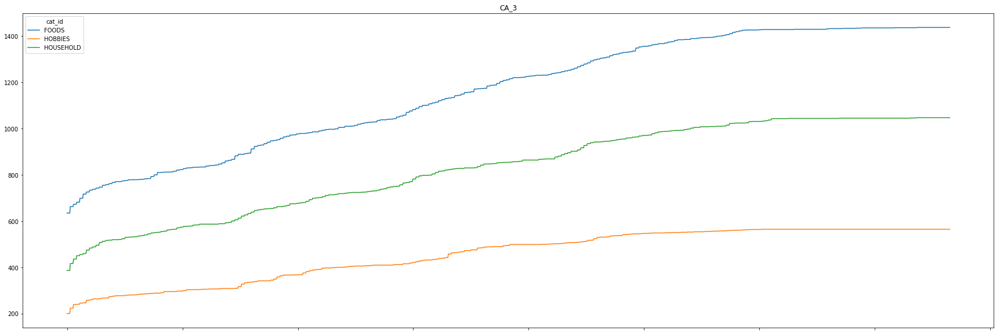

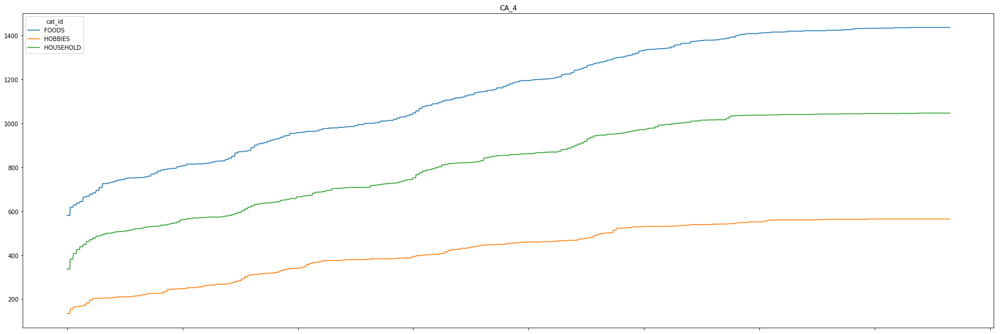

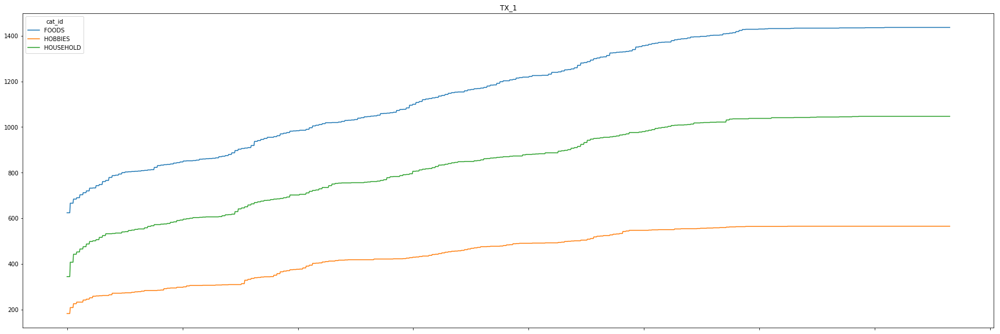

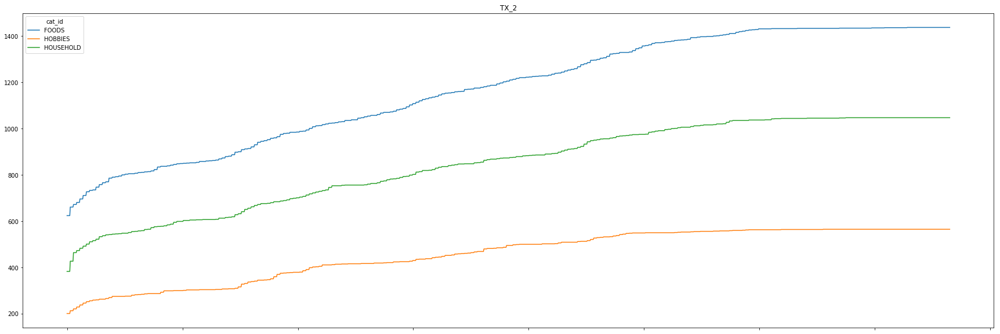

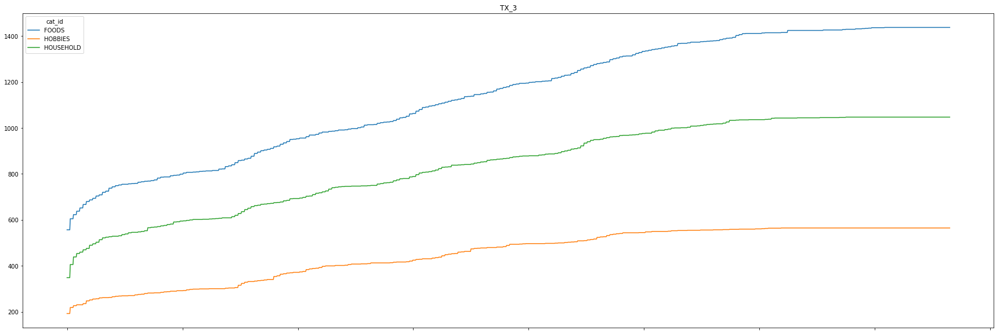

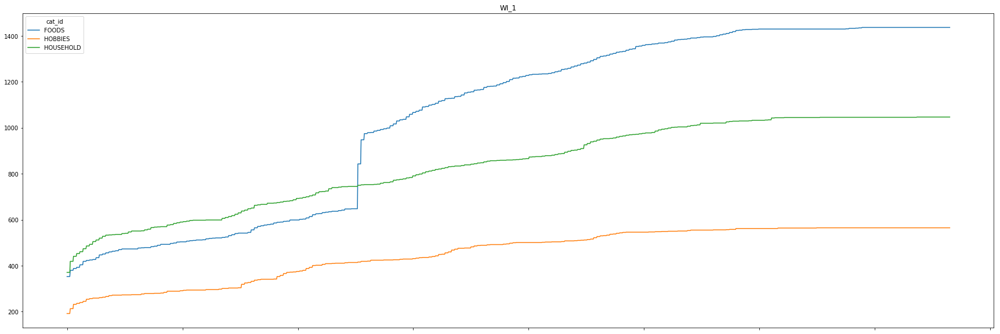

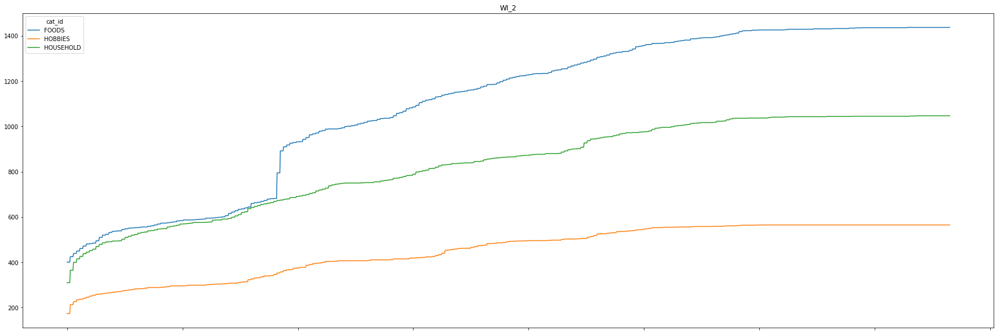

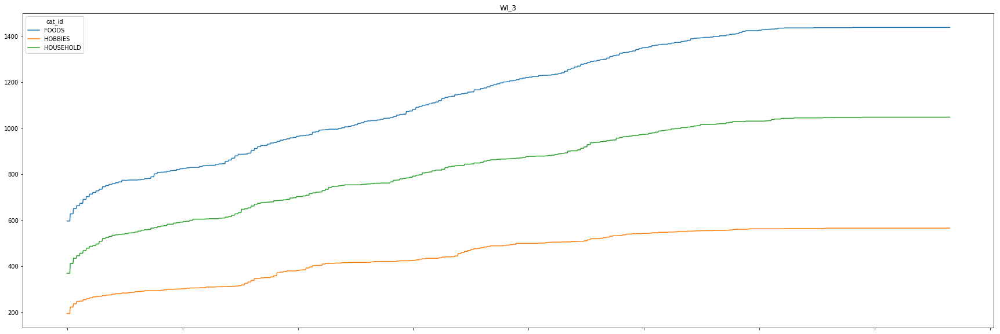

In [78]:
for store in train_df.store_id.unique():
    tmp_df = is_sell[is_sell.store_id==store]
    tmp_df.groupby(['cat_id'])[d_cols].sum().T.plot(figsize=(30,10))
    plt.title(store)

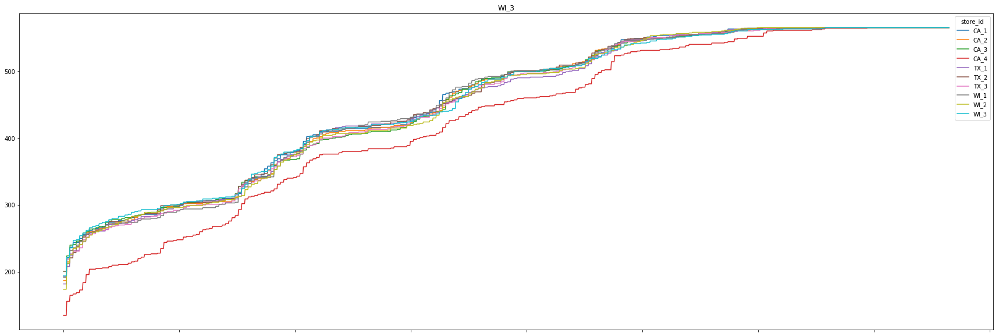

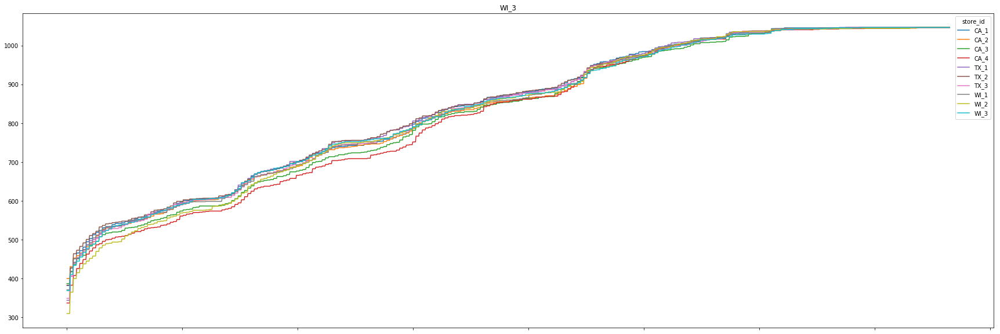

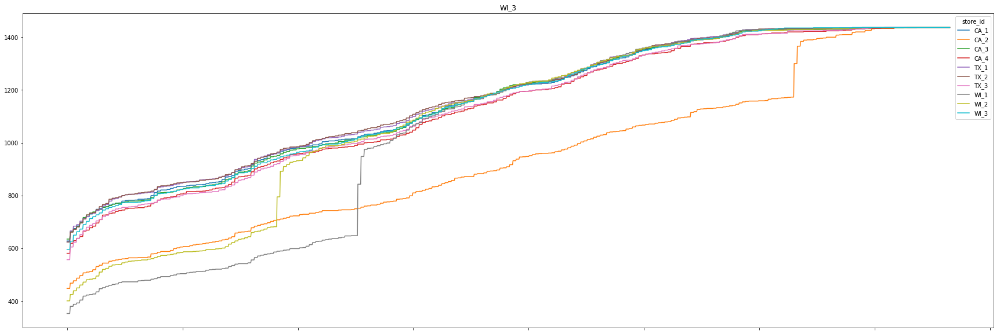

In [82]:
for cat in train_df.cat_id.unique():
    tmp_df = is_sell[is_sell.cat_id==cat]
    tmp_df.groupby(['store_id'])[d_cols].sum().T.plot(figsize=(30,10))
    plt.title(store)

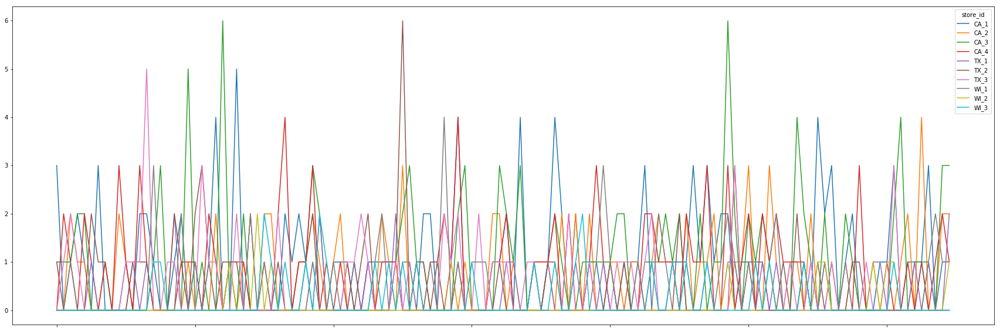

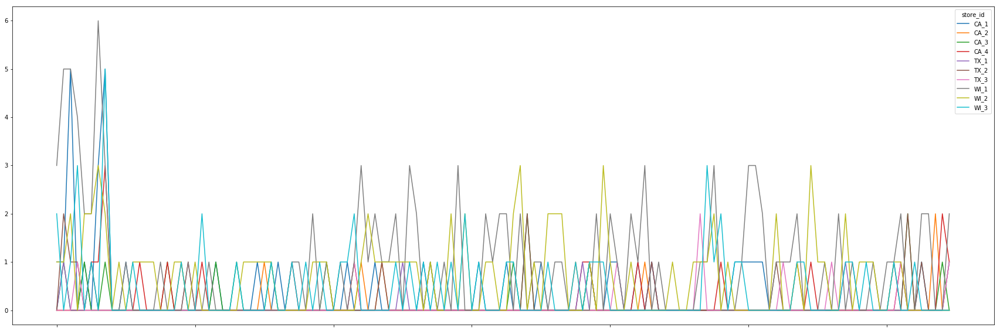

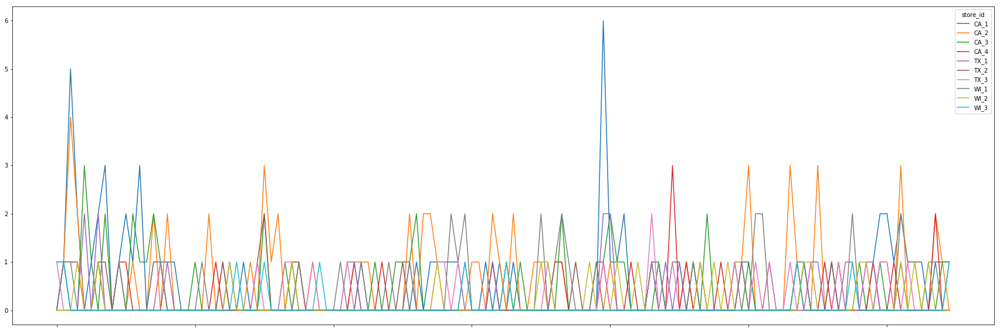

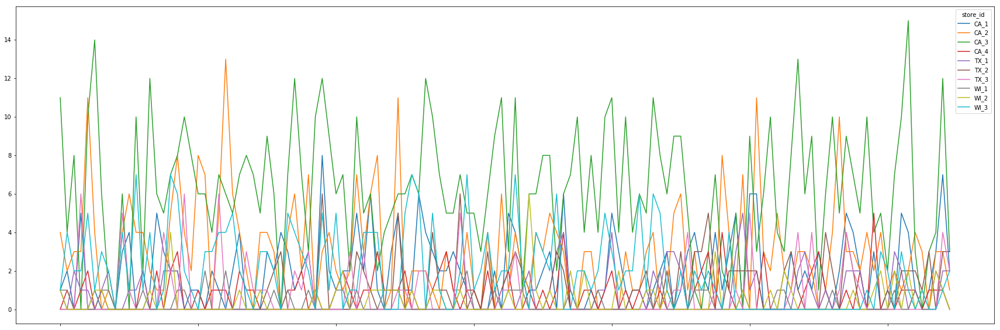

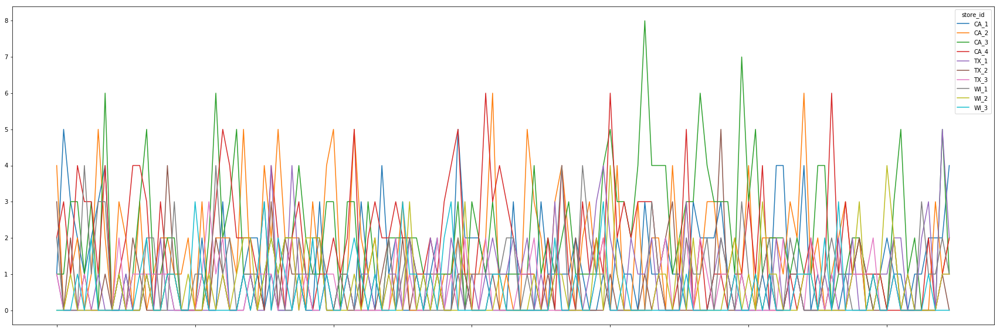

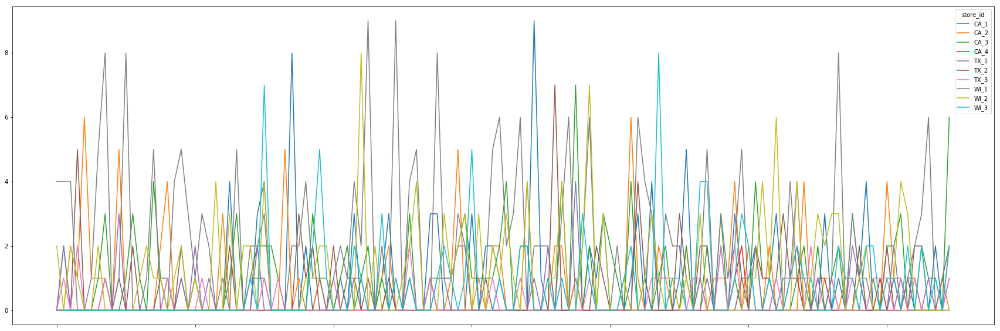

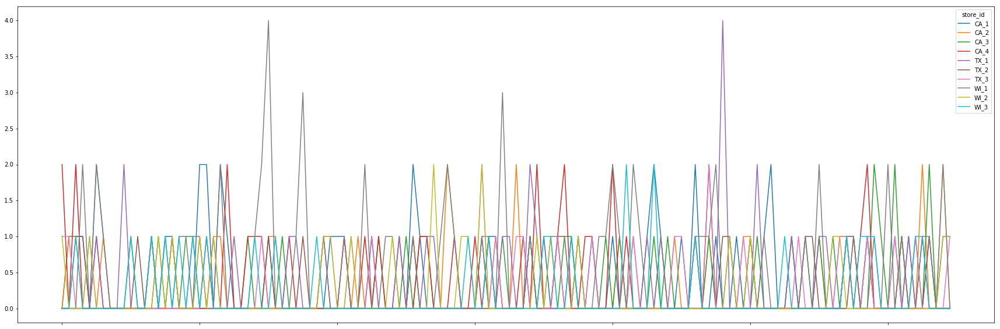

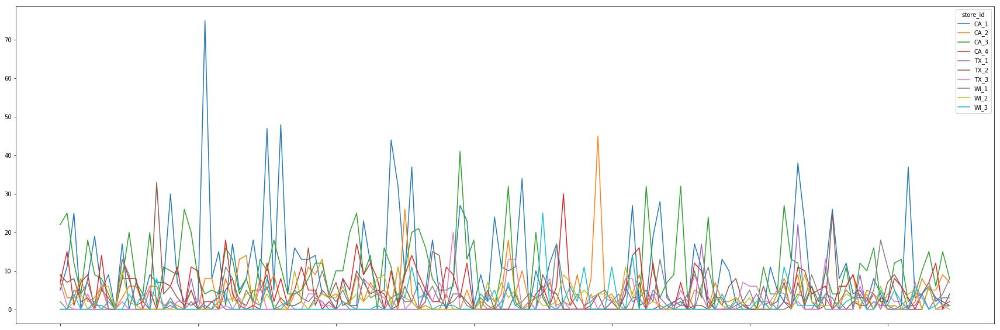

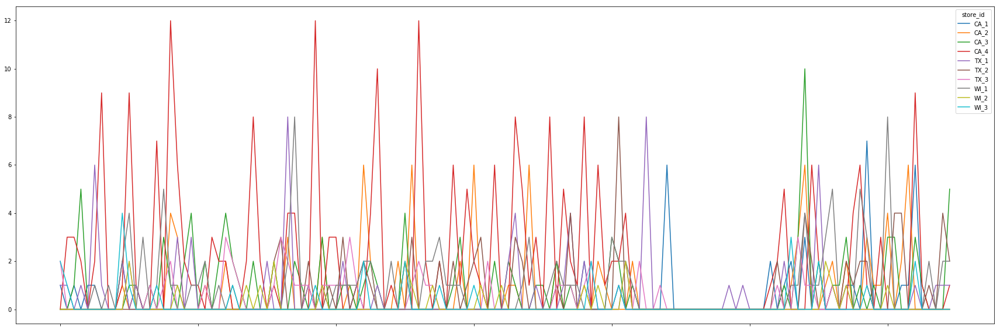

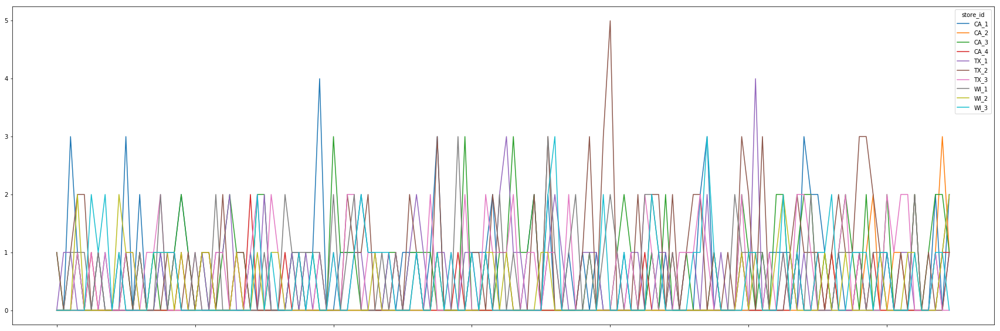

In [104]:
for item in train_df.item_id.unique()[:10]:
    tmp = train_df[train_df.item_id==item]
    tmp.groupby(['store_id'])[d_cols[-130:]].sum().T.plot(figsize=(30,10))

In [7]:
df = train_df.T

In [8]:
item_id = train_df.id.values

In [9]:
df.loc[d_cols] = df.loc[d_cols].astype(int)

In [10]:
df.columns = df.loc['id', :]

In [11]:
df.reset_index(inplace=True)

In [12]:
df.index = df['index']

In [13]:
calendar_dict = calendar_df.set_index('d').to_dict()

In [14]:
for key, value in calendar_dict.items():
    df[key] = df['index'].map(value)
df.drop('index', axis=1, inplace=True)

In [74]:
df[df.event_name_1=='SuperBowl'][item_id].mean(0).mean()

1.3422105608396062

In [75]:
df.loc[d_cols][df.event_name_1!='SuperBowl'][item_id].mean(0).mean()

1.1256429033701048

In [135]:
def autocorrelation(data, k):
    """Returns the autocorrelation of the *k*th lag in a time series data.

    Parameters
    ----------
    data : one dimentional numpy array
    k : the *k*th lag in the time series data (indexing starts at 0)
    """

    # yの平均
    y_avg = np.mean(data)

    # 分子の計算
    sum_of_covariance = 0
    for i in range(k+1, len(data)):
        covariance = ( data[i] - y_avg ) * ( data[i-(k+1)] - y_avg )
        sum_of_covariance += covariance

    # 分母の計算
    sum_of_denominator = 0
    for u in range(len(data)):
        denominator = ( data[u] - y_avg )**2
        sum_of_denominator += denominator

    return sum_of_covariance / sum_of_denominator

In [101]:
for i in range(1,10):
    print(f'{i}     {autocorrelation(b, i)}')

1     0.33816278067435357
2     0.23713744122990096
3     0.22485511175384232
4     0.29995872133612045
5     0.4038113943658055
6     0.38202212571728733
7     0.31065387157230867
8     0.25173742528395265
9     0.24285149448406715


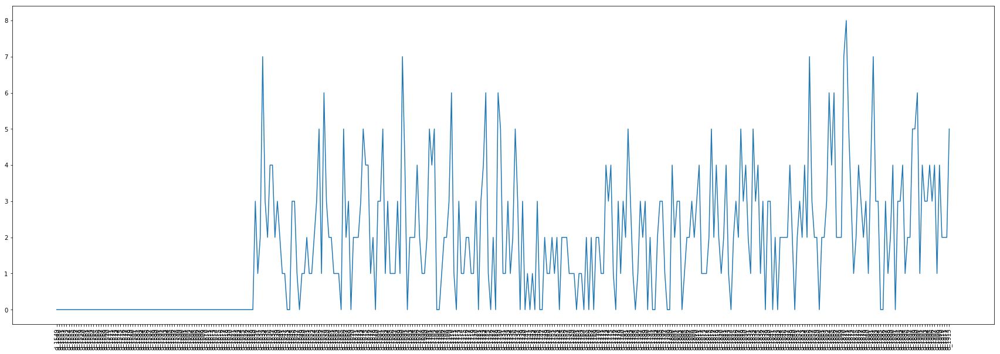

In [104]:
plt.figure(figsize=(30,10))
plt.xticks(rotation=90)
plt.plot(b)

In [108]:
df.loc[d_cols].head()

id,HOBBIES_1_001_CA_1_validation,HOBBIES_1_002_CA_1_validation,HOBBIES_1_003_CA_1_validation,HOBBIES_1_004_CA_1_validation,HOBBIES_1_005_CA_1_validation,HOBBIES_1_006_CA_1_validation,HOBBIES_1_007_CA_1_validation,HOBBIES_1_008_CA_1_validation,HOBBIES_1_009_CA_1_validation,HOBBIES_1_010_CA_1_validation,...,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
index,,,,,,,,,,,,,,,,,,,,,
d_1,0,0,0,0,0,0,0,12,2,0,...,1.0,1.0,2011.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_2,0,0,0,0,0,0,0,15,0,0,...,2.0,1.0,2011.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_3,0,0,0,0,0,0,0,0,7,1,...,3.0,1.0,2011.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_4,0,0,0,0,0,0,0,0,3,0,...,4.0,2.0,2011.0,NaN,NaN,NaN,NaN,1.0,1.0,0.0
d_5,0,0,0,0,0,0,0,0,0,0,...,5.0,2.0,2011.0,NaN,NaN,NaN,NaN,1.0,0.0,1.0


In [109]:
is_sell.head()

d,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,...,d_1960,d_1961,d_1962,d_1963,d_1964,d_1965,d_1966,d_1967,d_1968,d_1969
HOBBIES_1_001_CA_1_validation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
HOBBIES_1_002_CA_1_validation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
HOBBIES_1_003_CA_1_validation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
HOBBIES_1_004_CA_1_validation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
HOBBIES_1_005_CA_1_validation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [17]:
df.loc[d_cols[-10:]]

id,HOBBIES_1_001_CA_1_validation,HOBBIES_1_002_CA_1_validation,HOBBIES_1_003_CA_1_validation,HOBBIES_1_004_CA_1_validation,HOBBIES_1_005_CA_1_validation,HOBBIES_1_006_CA_1_validation,HOBBIES_1_007_CA_1_validation,HOBBIES_1_008_CA_1_validation,HOBBIES_1_009_CA_1_validation,HOBBIES_1_010_CA_1_validation,...,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
index,,,,,,,,,,,,,,,,,,,,,
d_1904,1,0,2,1,2,0,0,0,0,1,...,7.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,1.0,1.0
d_1905,3,0,1,0,1,1,0,0,0,0,...,1.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_1906,0,0,2,5,1,0,0,1,1,0,...,2.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_1907,1,0,1,4,0,1,1,37,1,0,...,3.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_1908,1,0,1,1,1,0,0,3,6,0,...,4.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_1909,1,1,1,0,1,0,1,4,0,0,...,5.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_1910,3,0,0,1,2,0,0,6,0,0,...,6.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_1911,0,0,1,3,2,2,0,3,0,2,...,7.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0
d_1912,1,0,1,7,2,0,1,2,0,0,...,1.0,4.0,2016.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0


In [30]:
train_df.groupby(['dept_id'])[d_cols[-100:]].std()#.mean(1).reset_index().sort_values('dept_id')

,d_1814,d_1815,d_1816,d_1817,d_1818,d_1819,d_1820,d_1821,d_1822,d_1823,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,0,0,0,2,1,2,1,0,0,0,...,1,3,0,1,1,1,3,0,1,1
1,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,2,1,2,1,1,1,0,1,1,1
3,3,2,4,3,1,2,3,0,8,2,...,1,0,5,4,1,0,1,3,7,2
4,0,1,0,0,0,1,0,0,3,0,...,2,1,1,0,1,1,2,2,2,4
5,4,0,0,0,8,0,2,0,1,0,...,0,1,0,1,0,0,0,2,0,0
6,1,0,0,0,0,0,0,0,0,1,...,0,0,0,1,0,1,0,0,1,1
7,47,5,48,4,16,13,13,14,4,3,...,0,0,1,37,3,4,6,3,2,1
8,0,0,0,0,0,0,0,0,0,0,...,0,0,1,1,6,0,0,0,0,0
9,0,0,0,0,1,1,0,1,4,0,...,1,0,0,0,0,0,0,2,0,2


In [36]:
train_df.index = train_df.id

In [47]:
_id = train_df[d_cols[-200:]].mean(1).sort_values(ascending=False).index

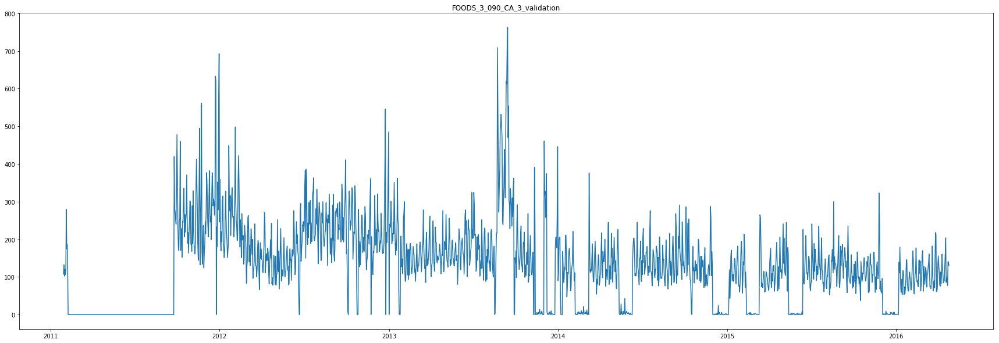

In [68]:
d=d_cols
tmp_id = _id[0]

plt.figure(figsize=(30,10))
plt.plot_date(calendar_df[calendar_df.d.isin(d)].date, train_df.loc[tmp_id,:][d],fmt='-' )
plt.title(tmp_id)
plt.show()

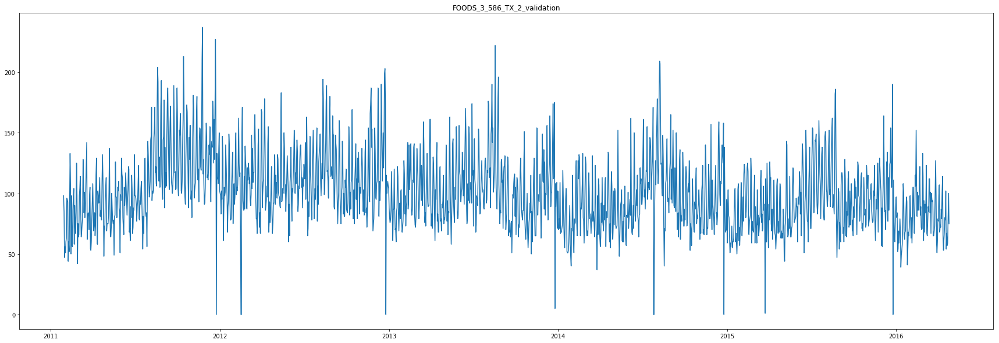

In [69]:
d=d_cols
tmp_id = _id[1]
plt.figure(figsize=(30,10))
plt.plot_date(calendar_df[calendar_df.d.isin(d)].date, train_df.loc[tmp_id,:][d],fmt='-' )
plt.title(tmp_id)
plt.show()

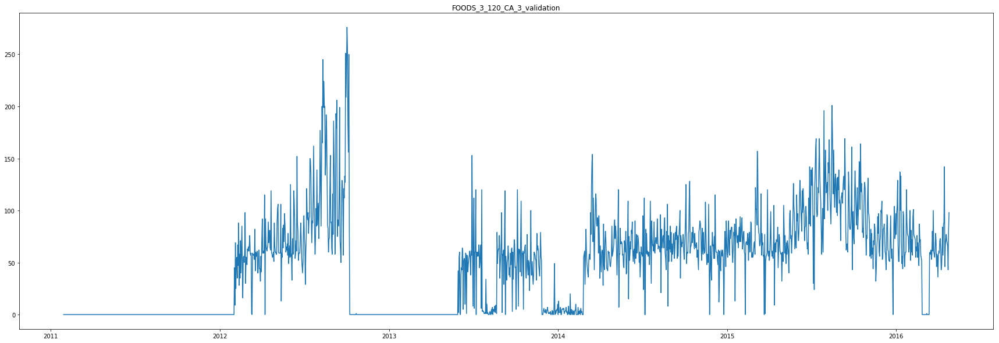

In [70]:
d=d_cols
tmp_id = _id[2]

plt.figure(figsize=(30,10))
plt.plot_date(calendar_df[calendar_df.d.isin(d)].date, train_df.loc[tmp_id,:][d],fmt='-' )
plt.title(tmp_id)
plt.show()

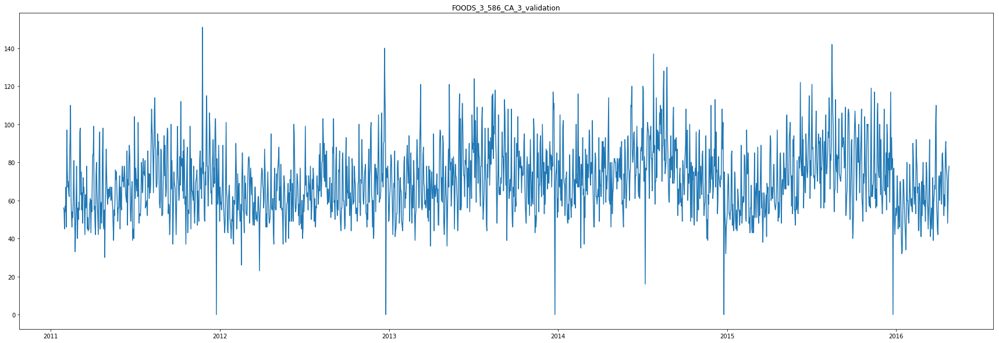

In [71]:
d=d_cols
tmp_id = _id[3]

plt.figure(figsize=(30,10))
plt.plot_date(calendar_df[calendar_df.d.isin(d)].date, train_df.loc[tmp_id,:][d],fmt='-' )
plt.title(tmp_id)
plt.show()

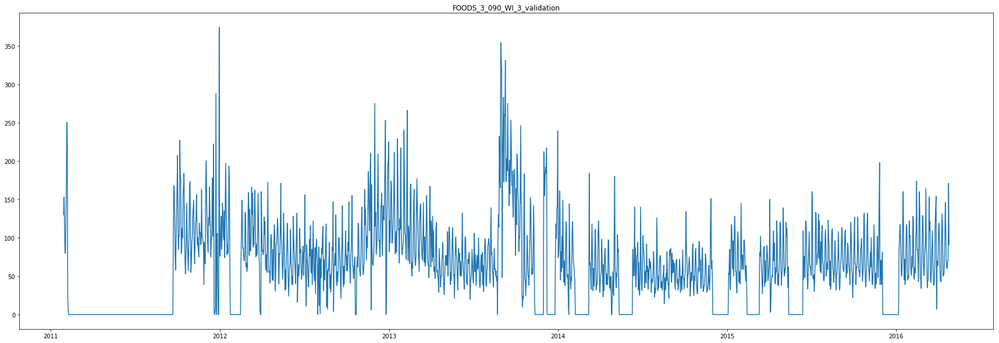

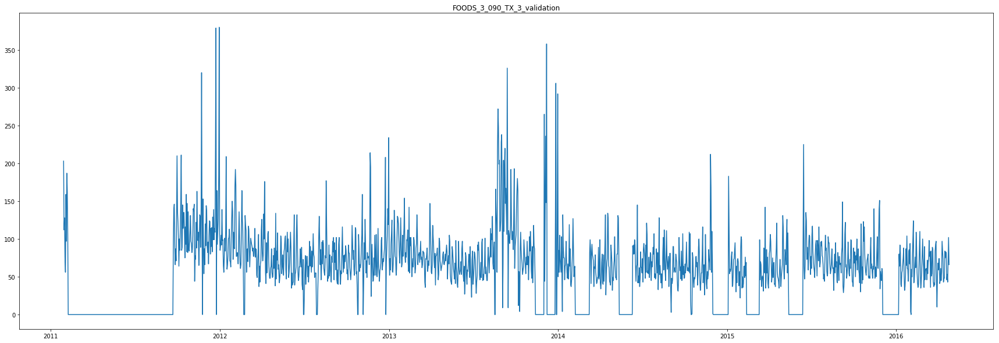

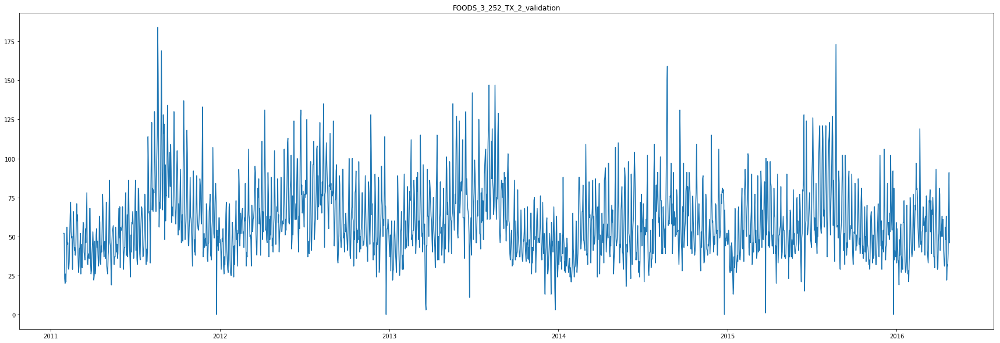

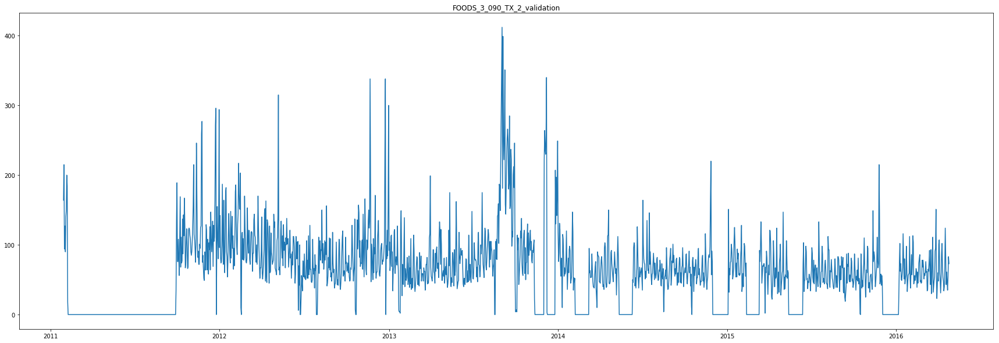

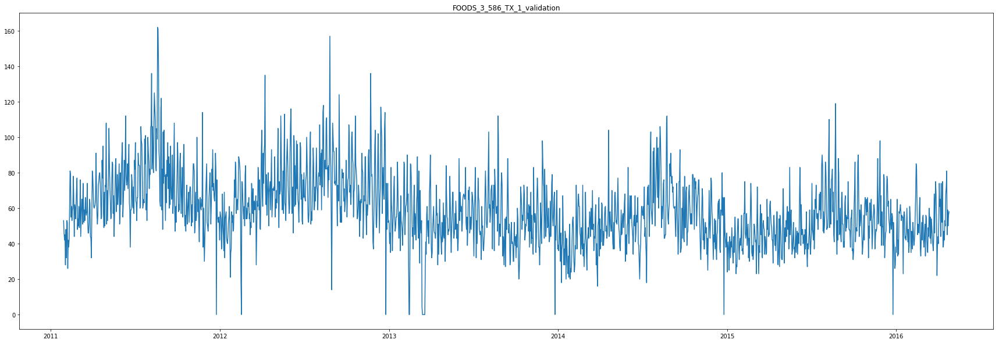

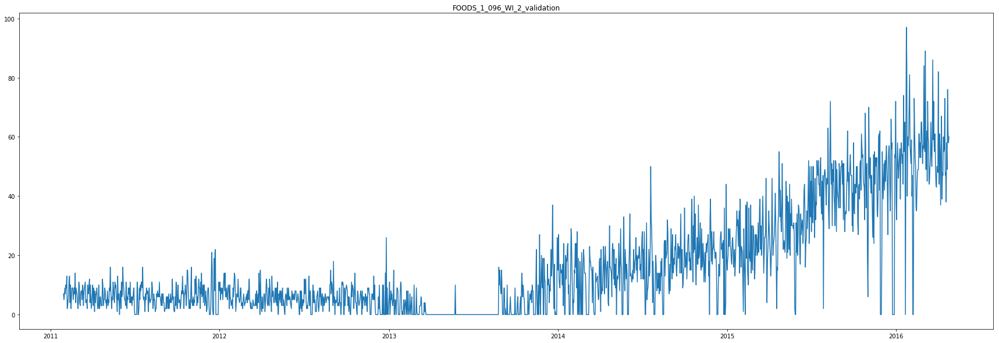

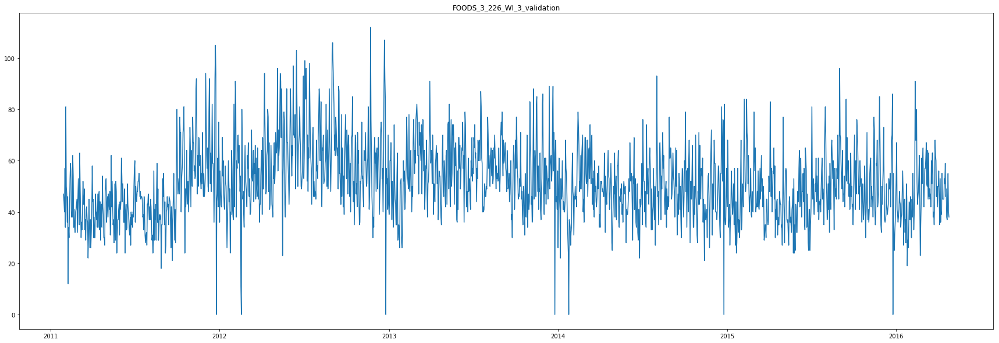

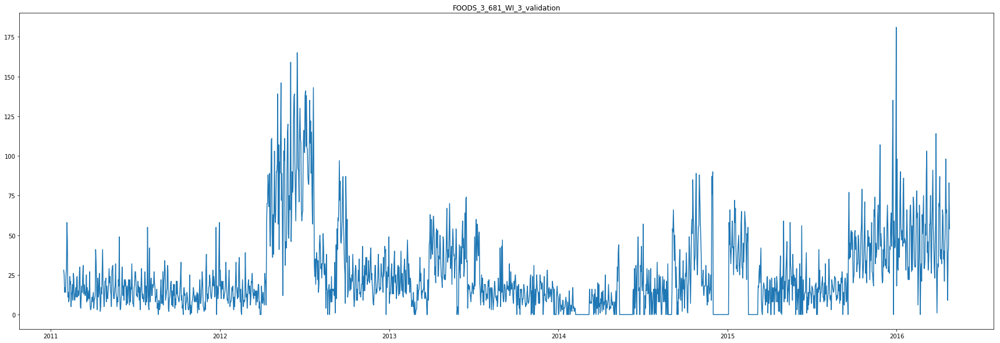

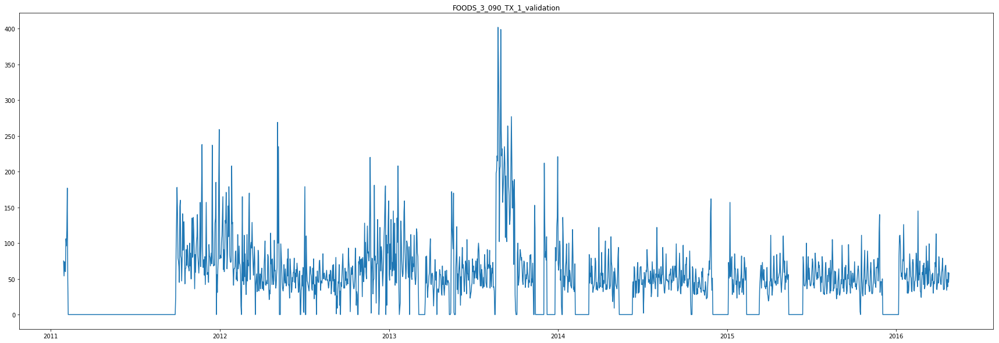

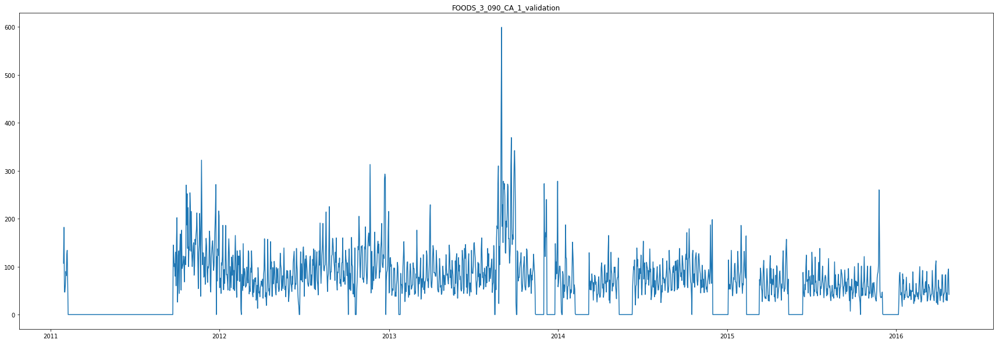

In [72]:
for i in range(5,15):
    d=d_cols
    tmp_id = _id[i]

    plt.figure(figsize=(30,10))
    plt.plot_date(calendar_df[calendar_df.d.isin(d)].date, train_df.loc[tmp_id,:][d],fmt='-' )
    plt.title(tmp_id)
    plt.show()

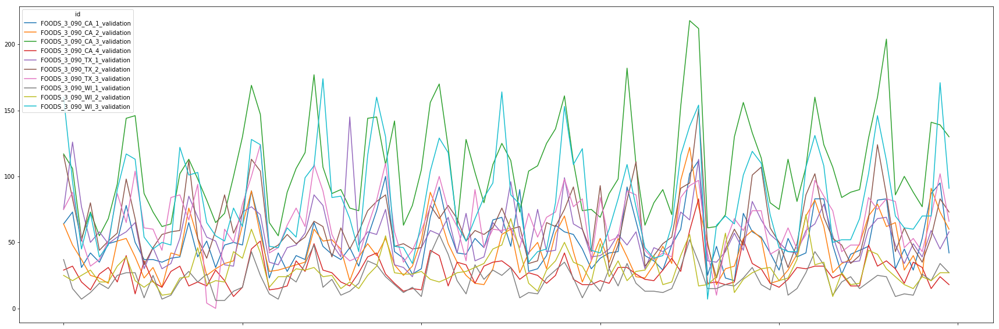

In [78]:
train_df[train_df.item_id=='FOODS_3_090'][d[-100:]].T.plot(figsize=(30,10))

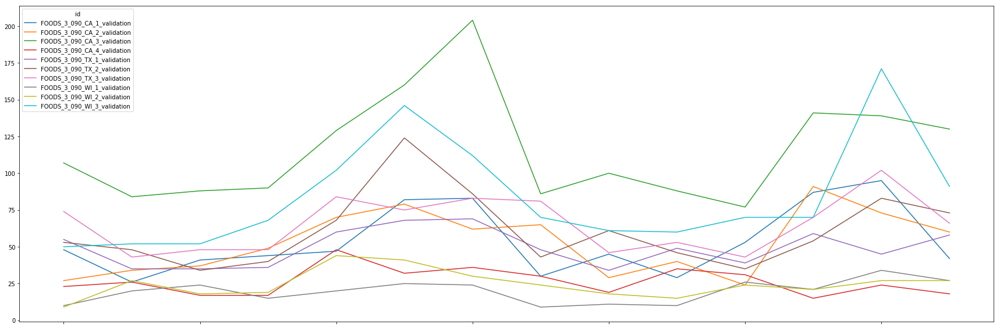

In [81]:
train_df[train_df.item_id=='FOODS_3_090'][d[-14:]].T.plot(figsize=(30,10))

In [84]:
train_df[train_df.item_id=='FOODS_3_090'].sum(1).sort_values()

id
FOODS_3_090_WI_2_validation     32071
FOODS_3_090_WI_1_validation     34852
FOODS_3_090_CA_4_validation     52264
FOODS_3_090_CA_2_validation     56169
FOODS_3_090_TX_1_validation     93684
FOODS_3_090_TX_3_validation    114854
FOODS_3_090_TX_2_validation    119496
FOODS_3_090_WI_3_validation    121434
FOODS_3_090_CA_1_validation    127203
FOODS_3_090_CA_3_validation    250502
dtype: int64

In [88]:
train_df.groupby(['store_id'])[d].sum().sum(1).sort_values()

store_id
CA_4     4103676
WI_1     5149062
TX_1     5595292
CA_2     5685475
TX_3     6089330
WI_3     6427782
WI_2     6544012
TX_2     7214384
CA_1     7698216
CA_3    11188180
dtype: int64

In [102]:
a = train_df.groupby(['item_id'])[d_cols[-100:]].mean().mean(1).sort_values()
a.head()

item_id
FOODS_3_444        0.000
HOBBIES_1_335      0.000
FOODS_3_441        0.000
HOUSEHOLD_2_202    0.008
HOBBIES_1_236      0.010
dtype: float64

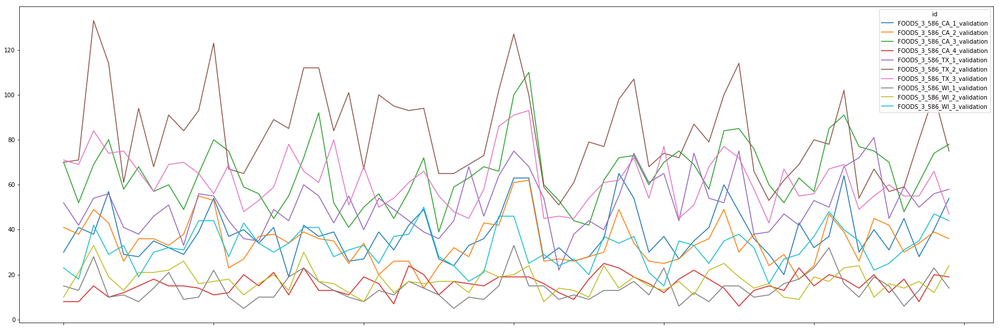

In [97]:
train_df[train_df.item_id=='FOODS_3_586'][d_cols[-60:]].T.plot(figsize=(30,10))

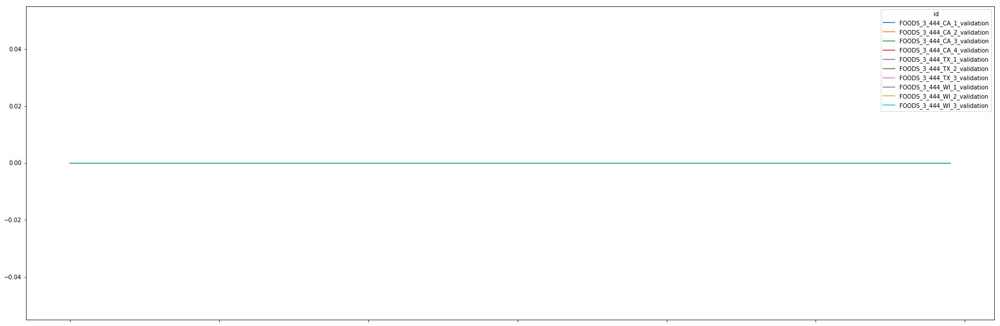

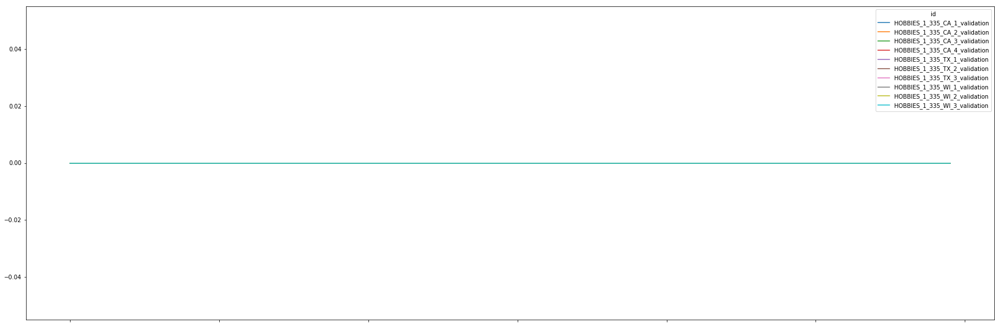

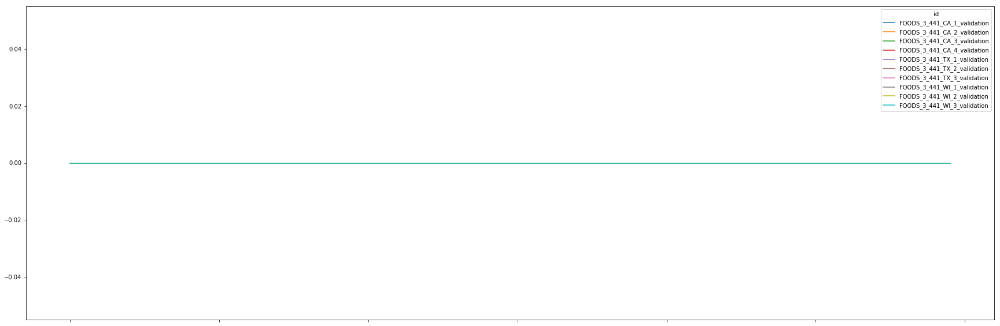

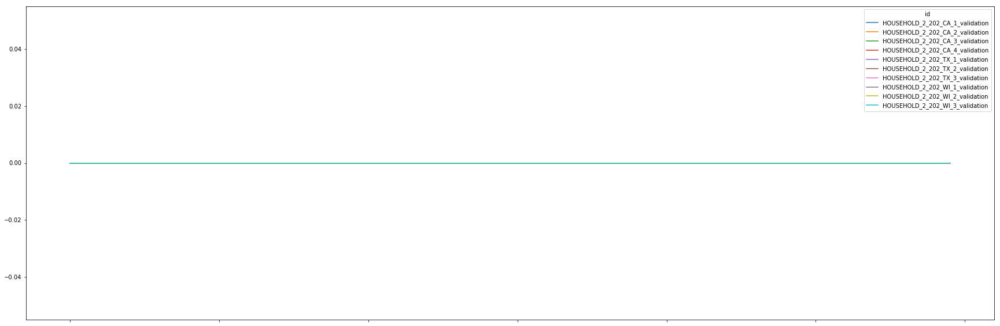

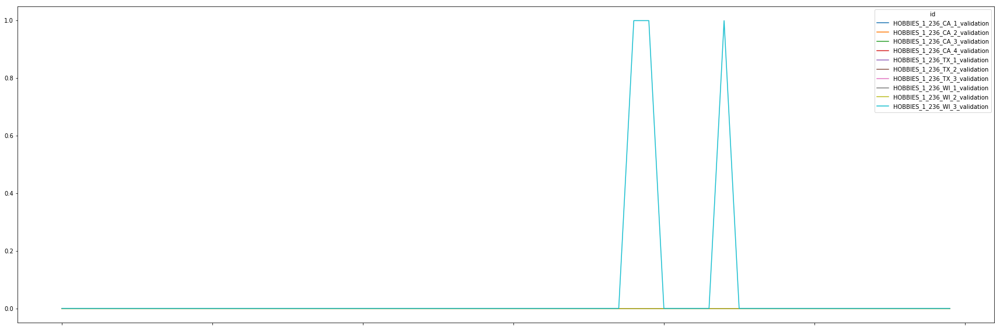

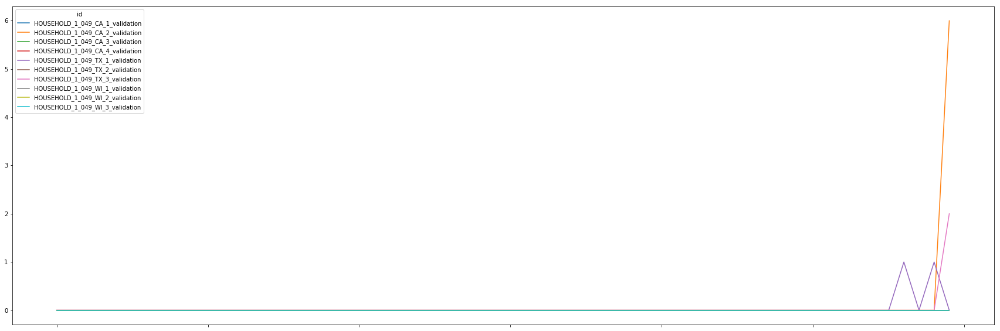

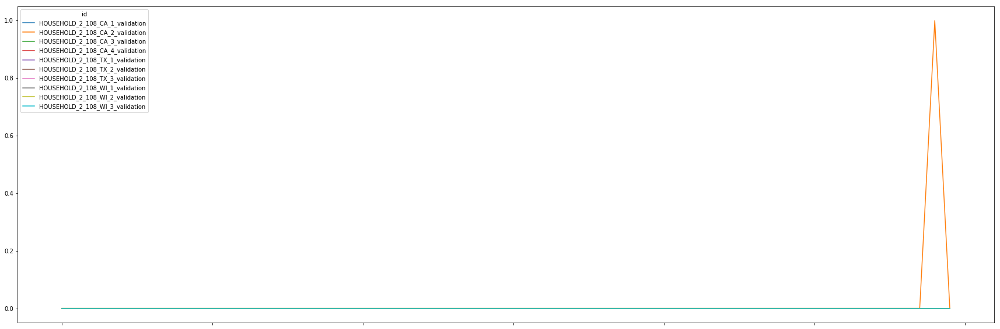

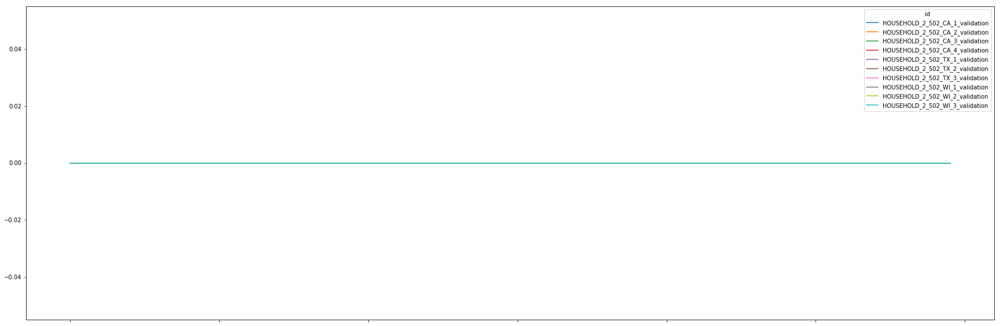

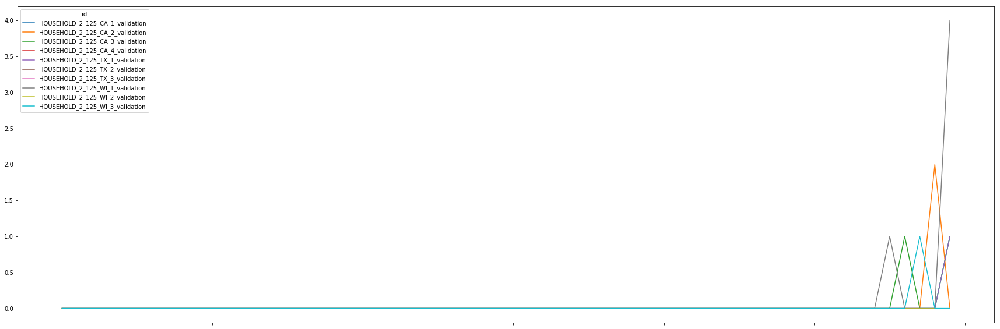

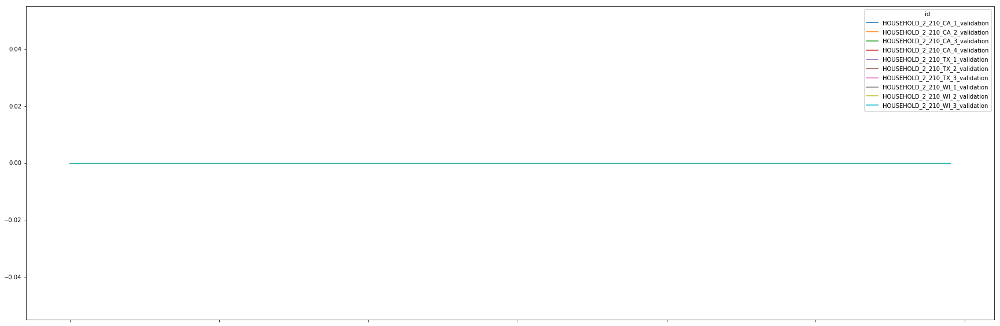

In [103]:
for _ in a.index[:10]:
    train_df[train_df.item_id==_][d_cols[-60:]].T.plot(figsize=(30,10))
    plt.show()

In [121]:
is_sell[is_sell.item_id.isin(a.index[:10])][d_cols[-100:]].sum().mean()

100.0

In [116]:
a.head(10)

item_id
FOODS_3_444        0.000
HOBBIES_1_335      0.000
FOODS_3_441        0.000
HOUSEHOLD_2_202    0.008
HOBBIES_1_236      0.010
HOUSEHOLD_1_049    0.010
HOUSEHOLD_2_108    0.010
HOUSEHOLD_2_502    0.013
HOUSEHOLD_2_125    0.013
HOUSEHOLD_2_210    0.014
dtype: float64

In [117]:
a.tail(10)

item_id
FOODS_3_226    19.167
FOODS_3_681    19.688
FOODS_3_694    19.726
FOODS_3_282    20.306
FOODS_3_120    22.611
FOODS_3_555    22.671
FOODS_3_587    26.214
FOODS_3_252    27.200
FOODS_3_586    40.722
FOODS_3_090    54.681
dtype: float64

In [122]:
train_df.groupby(['dept_id'])[d_cols[-100:]].mean().mean(1).sort_values()

dept_id
HOBBIES_2      0.249134
HOUSEHOLD_2    0.382249
HOBBIES_1      0.845190
FOODS_2        1.421756
FOODS_1        1.439810
HOUSEHOLD_1    1.513408
FOODS_3        2.306868
dtype: float64

In [132]:
train_df[train_df.dept_id=='HOUSEHOLD_1']#].groupby(['item_id'])#[d_cols[-100:]].sum()

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
id,,,,,,,,,,,,,,,,,,,,,
HOUSEHOLD_1_001_CA_1_validation,HOUSEHOLD_1_001_CA_1_validation,HOUSEHOLD_1_001,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,3,0,0,0,...,1,0,1,1,1,0,0,0,0,1
HOUSEHOLD_1_002_CA_1_validation,HOUSEHOLD_1_002_CA_1_validation,HOUSEHOLD_1_002,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,1,1,2,4,...,0,0,0,0,0,1,0,0,0,1
HOUSEHOLD_1_003_CA_1_validation,HOUSEHOLD_1_003_CA_1_validation,HOUSEHOLD_1_003,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,0,0,0,0,...,0,0,1,2,1,0,0,0,1,0
HOUSEHOLD_1_004_CA_1_validation,HOUSEHOLD_1_004_CA_1_validation,HOUSEHOLD_1_004,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,4,0,8,11,...,0,5,0,0,0,0,0,0,1,0
HOUSEHOLD_1_005_CA_1_validation,HOUSEHOLD_1_005_CA_1_validation,HOUSEHOLD_1_005,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,0,3,2,2,...,1,0,3,1,2,0,0,1,0,1
HOUSEHOLD_1_006_CA_1_validation,HOUSEHOLD_1_006_CA_1_validation,HOUSEHOLD_1_006,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,0,0,0,0,...,3,4,2,6,3,2,2,1,3,4
HOUSEHOLD_1_007_CA_1_validation,HOUSEHOLD_1_007_CA_1_validation,HOUSEHOLD_1_007,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,0,0,0,0,...,0,3,1,1,1,3,0,5,3,2
HOUSEHOLD_1_008_CA_1_validation,HOUSEHOLD_1_008_CA_1_validation,HOUSEHOLD_1_008,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,0,0,0,0,...,0,0,1,0,0,2,0,0,1,0
HOUSEHOLD_1_009_CA_1_validation,HOUSEHOLD_1_009_CA_1_validation,HOUSEHOLD_1_009,HOUSEHOLD_1,HOUSEHOLD,CA_1,CA,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


In [138]:
indx = a.tail(10).index

In [145]:
b = train_df[train_df.item_id==indx[0]][d_cols].iloc[0,:]

In [147]:
train_df[train_df.item_id==indx[0]]

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,...,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
id,,,,,,,,,,,,,,,,,,,,,
FOODS_3_226_CA_1_validation,FOODS_3_226_CA_1_validation,FOODS_3_226,FOODS_3,FOODS,CA_1,CA,13,9,2,10,...,8,3,8,3,4,1,4,8,4,10
FOODS_3_226_CA_2_validation,FOODS_3_226_CA_2_validation,FOODS_3_226,FOODS_3,FOODS,CA_2,CA,4,2,5,1,...,6,4,4,7,5,4,5,1,6,4
FOODS_3_226_CA_3_validation,FOODS_3_226_CA_3_validation,FOODS_3_226,FOODS_3,FOODS,CA_3,CA,9,7,3,6,...,5,12,9,7,9,7,5,11,9,10
FOODS_3_226_CA_4_validation,FOODS_3_226_CA_4_validation,FOODS_3_226,FOODS_3,FOODS,CA_4,CA,3,0,1,1,...,2,2,5,4,4,3,6,5,1,2
FOODS_3_226_TX_1_validation,FOODS_3_226_TX_1_validation,FOODS_3_226,FOODS_3,FOODS,TX_1,TX,10,14,10,6,...,9,21,15,12,15,10,13,21,21,18
FOODS_3_226_TX_2_validation,FOODS_3_226_TX_2_validation,FOODS_3_226,FOODS_3,FOODS,TX_2,TX,25,7,11,11,...,10,9,13,11,6,9,7,12,10,11
FOODS_3_226_TX_3_validation,FOODS_3_226_TX_3_validation,FOODS_3_226,FOODS_3,FOODS,TX_3,TX,3,9,8,7,...,19,19,14,12,10,17,7,17,18,7
FOODS_3_226_WI_1_validation,FOODS_3_226_WI_1_validation,FOODS_3_226,FOODS_3,FOODS,WI_1,WI,50,46,18,28,...,38,56,58,42,27,34,24,41,41,38
FOODS_3_226_WI_2_validation,FOODS_3_226_WI_2_validation,FOODS_3_226,FOODS_3,FOODS,WI_2,WI,46,30,21,38,...,60,56,67,40,31,40,50,48,43,38


In [151]:
for m in range(10):
    tmp = train_df[train_df.item_id==indx[m]]
    for l in range(10):
        print("############################################################################")
        print(f"########{tmp.index[l]}##########")
        print("############################################################################")
        b = tmp[d_cols].iloc[l,:]
        for i in range(1,15):
            print(f'{i}   {autocorrelation(b, i)}')

############################################################################
########FOODS_3_226_CA_1_validation##########
############################################################################
1   0.27441643565863316
2   0.17232975403040984
3   0.16013621318699292
4   0.2021923870864459
5   0.3337078119560996
6   0.4284233024479829
7   0.331713955851526
8   0.2006702890336084
9   0.13019828153159976
10   0.11081714116499154
11   0.19113070338922772
12   0.3186573848084892
13   0.3942884389614084
14   0.3216053804117893
############################################################################
########FOODS_3_226_CA_2_validation##########
############################################################################
1   0.19292141767755716
2   0.09693099658919836
3   0.11055832019020621
4   0.16039608520999363
5   0.2839365154699405
6   0.3550352319676381
7   0.26618399429387596
8   0.12858267534813786
9   0.08812280910767424
10   0.07095155742856865
11   0.15474861233493495
12  

1   0.48619693496556243
2   0.4005160187901856
3   0.39263469070313395
4   0.3804571681010605
5   0.38424729148937575
6   0.38285862473683885
7   0.3349610857097206
8   0.27783898581574407
9   0.23620660008762226
10   0.2287849199038116
11   0.22991010918277624
12   0.2801513818184607
13   0.2797737849558291
14   0.24365766560796742
############################################################################
########FOODS_3_681_TX_3_validation##########
############################################################################
1   0.5574203070237069
2   0.4859785144767499
3   0.44724813365913935
4   0.47228967166911434
5   0.4847757705393653
6   0.4954500411661864
7   0.44079341816730777
8   0.3531847676805331
9   0.32700954288778566
10   0.32051714387804603
11   0.33804305664756124
12   0.3564349184074423
13   0.3627831377001612
14   0.3236495844451559
############################################################################
########FOODS_3_681_WI_1_validation##########
#########

11   0.6533430730544713
12   0.6867619602871554
13   0.7281998347964822
14   0.6819498010388061
############################################################################
########FOODS_3_282_CA_2_validation##########
############################################################################
1   0.7199867414508888
2   0.6927570130711128
3   0.6685793883721182
4   0.667316923614482
5   0.7179554148615426
6   0.7481422084448763
7   0.6846003142412427
8   0.6210670088358307
9   0.5930952374277989
10   0.5751037883060263
11   0.5805989629323215
12   0.6161974868173721
13   0.638958757890445
14   0.5975329844191486
############################################################################
########FOODS_3_282_CA_3_validation##########
############################################################################
1   0.8132908044124875
2   0.7720977739813849
3   0.7538489367622131
4   0.7713246363642292
5   0.8020185912174529
6   0.8249110192694122
7   0.7842241042541781
8   0.728920451956

1   0.6213280111179313
2   0.6093091561068716
3   0.6113265476441766
4   0.6242833687661965
5   0.6595820632453401
6   0.7037545870386731
7   0.6267693191592614
8   0.5993841951179395
9   0.5714501711796153
10   0.5874497526661839
11   0.594852788315106
12   0.6080667633253358
13   0.6407551935049413
14   0.6055656597881731
############################################################################
########FOODS_3_120_WI_1_validation##########
############################################################################
1   0.6778680260300497
2   0.6118714406572012
3   0.6352922484536702
4   0.6466238164456115
5   0.7009938539909742
6   0.7343660603170151
7   0.6805338056133687
8   0.6364147522045308
9   0.602550446246172
10   0.5997553819088363
11   0.6183453688022169
12   0.649859375237359
13   0.7081432332067616
14   0.6388736633630293
############################################################################
########FOODS_3_120_WI_2_validation##########
##########################

11   0.47285779716415227
12   0.5321286302973885
13   0.5721401206875865
14   0.503503406128317
############################################################################
########FOODS_3_587_CA_3_validation##########
############################################################################
1   0.7890098524743965
2   0.7361019224355406
3   0.710236514351349
4   0.7087622365426464
5   0.7276440395504405
6   0.73415647771804
7   0.7150759359133761
8   0.6688744967735696
9   0.6452784838351504
10   0.6381513605281901
11   0.6434259187209478
12   0.6672902745676501
13   0.6875577467437649
14   0.6706007600145131
############################################################################
########FOODS_3_587_CA_4_validation##########
############################################################################
1   0.6419837778873878
2   0.5944282220518405
3   0.5692605102483779
4   0.5938428344742523
5   0.6252096539742874
6   0.6569490527716525
7   0.6210305323313786
8   0.5718598114917

1   0.09720618721619649
2   -0.009540447158532339
3   -0.021510777062015308
4   0.05137931749901556
5   0.26408331089720244
6   0.4210018978991723
7   0.2658776281774113
8   0.038481577308113454
9   -0.0423920797023496
10   -0.05175952592605244
11   0.04354742050132228
12   0.23538024593205595
13   0.389359806602106
14   0.26779560182707657
############################################################################
########FOODS_3_252_WI_2_validation##########
############################################################################
1   0.3586829673764741
2   0.32458919196112845
3   0.3112014269755106
4   0.24256539822946416
5   0.2575036747847857
6   0.3140702339526152
7   0.2800010791297148
8   0.2414364806758489
9   0.24750064301940056
10   0.25032483526226157
11   0.2465332553799888
12   0.27108658386394385
13   0.29176585252420645
14   0.20011323412337437
############################################################################
########FOODS_3_252_WI_3_validation##########


10   0.49546317991078653
11   0.5149046689152659
12   0.5607426724166049
13   0.5793306888693243
14   0.5347112966958131
############################################################################
########FOODS_3_090_CA_4_validation##########
############################################################################
1   0.5603595585176759
2   0.4622589004090477
3   0.44263376783976927
4   0.48944699602830405
5   0.5524060418652963
6   0.6029422366603191
7   0.5306354426197023
8   0.42708414061758515
9   0.36235774955956457
10   0.3559526763897371
11   0.39187683985145416
12   0.47707182667782266
13   0.5019941528801801
14   0.4377101220679065
############################################################################
########FOODS_3_090_TX_1_validation##########
############################################################################
1   0.5966773882582386
2   0.5167057587550883
3   0.5031000829202421
4   0.5130730322061147
5   0.5329842659441163
6   0.5527326957778095
7   0.51

In [183]:
#train_df.id.unique()

In [184]:
item_id = train_df[train_df.item_id.isin(m)].id

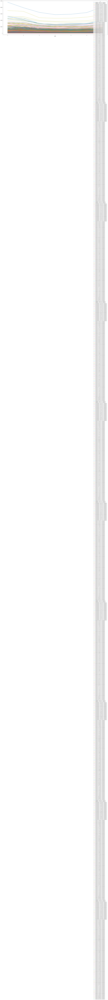

In [187]:
df.loc[d_cols].groupby(['wday'])[item_id].sum().plot(figsize=(30,10))

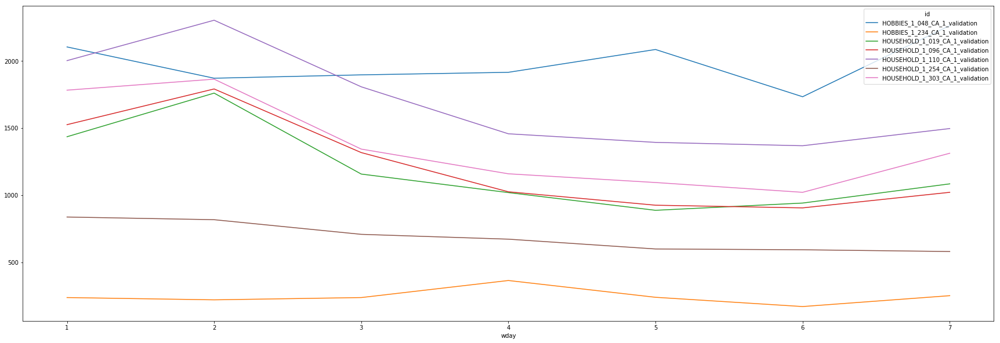

In [189]:
df.loc[d_cols].groupby(['wday'])[item_id[:7]].sum().plot(figsize=(30,10))

In [26]:
train_df.index = train_df.id

In [32]:
std  = (is_sell.replace(0, np.nan).replace(1,0)[d_cols]+train_df[d_cols]).std(1)
mean  = (is_sell.replace(0, np.nan).replace(1,0)[d_cols]+train_df[d_cols]).mean(1)

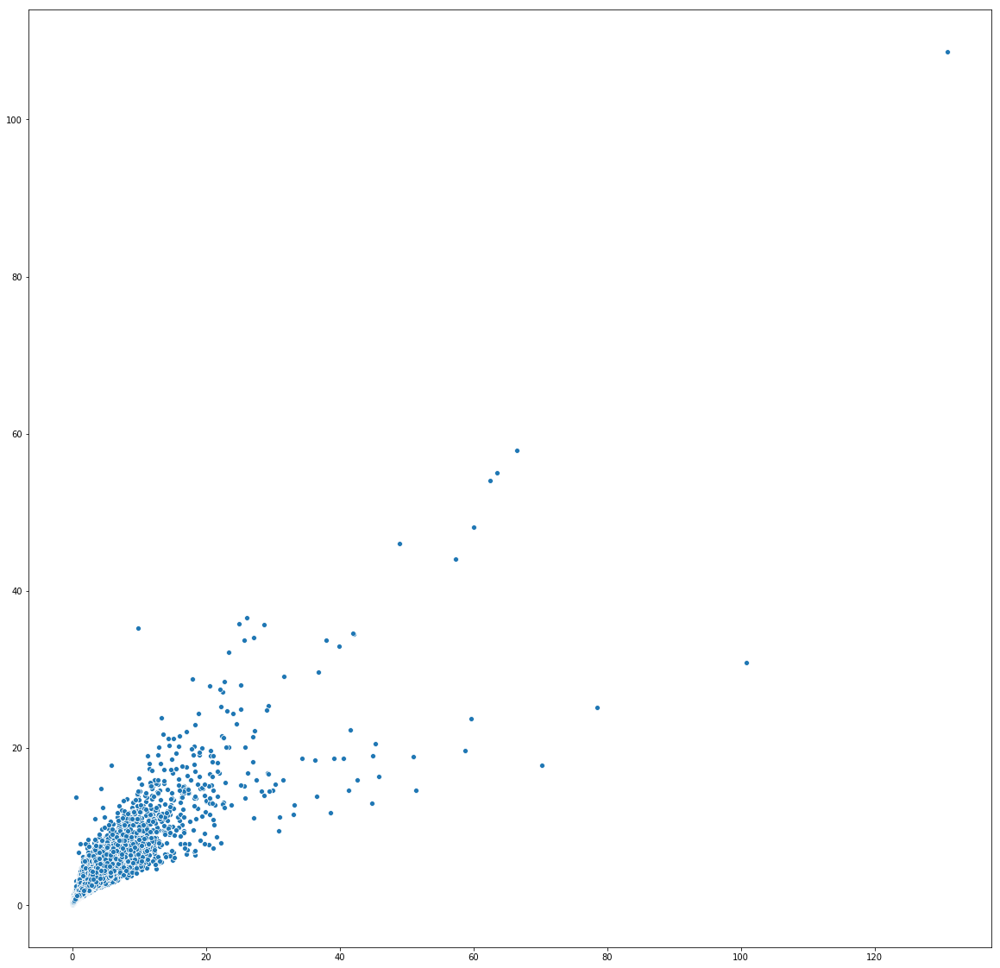

In [44]:
plt.figure(figsize=(20,20))
sns.scatterplot(mean, std)

In [45]:
mean.sort_values()[:5], mean.sort_values()[-5:]

(HOUSEHOLD_1_512_CA_4_validation    0.010455
 HOUSEHOLD_1_336_CA_3_validation    0.012346
 HOUSEHOLD_1_073_CA_3_validation    0.013899
 HOUSEHOLD_1_020_CA_3_validation    0.015314
 HOBBIES_1_006_CA_4_validation      0.016667
 dtype: float64, FOODS_3_090_CA_1_validation     66.493988
 FOODS_3_586_CA_3_validation     70.248824
 FOODS_3_586_TX_3_validation     78.474647
 FOODS_3_586_TX_2_validation    100.802405
 FOODS_3_090_CA_3_validation    130.947203
 dtype: float64)

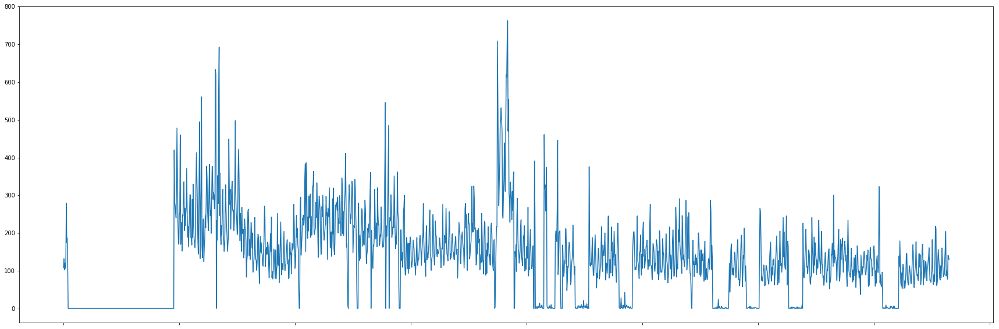

In [39]:
train_df.loc['FOODS_3_090_CA_3_validation'].loc[d_cols].plot(figsize=(30,10))

In [74]:
price_mean = price_data.replace(0, np.nan).mean(0)

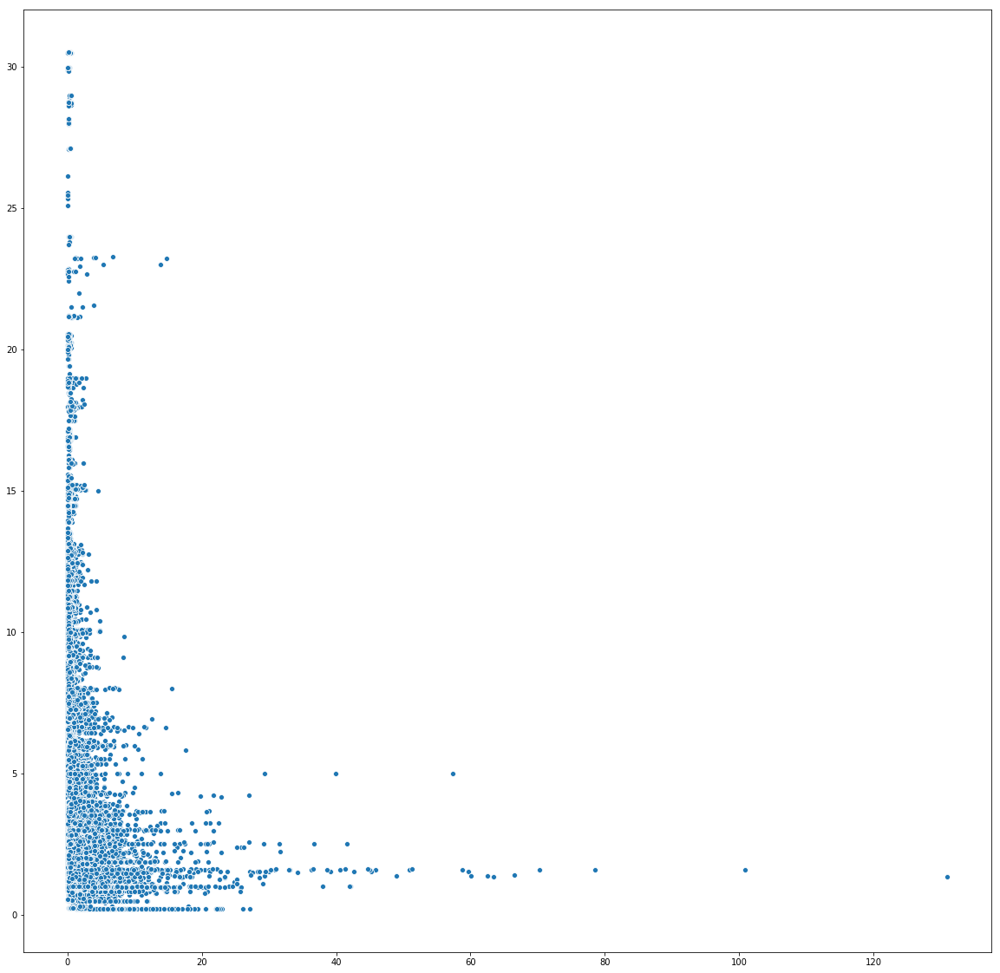

In [75]:
plt.figure(figsize=(20,20))
sns.scatterplot(mean, price_mean)

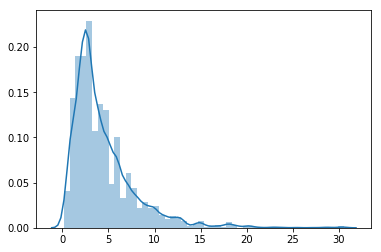

In [76]:
sns.distplot(price_mean)

In [77]:
price_mean = np.log(price_mean)

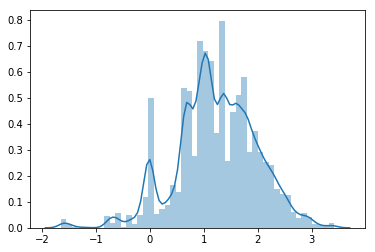

In [78]:
sns.distplot(price_mean)

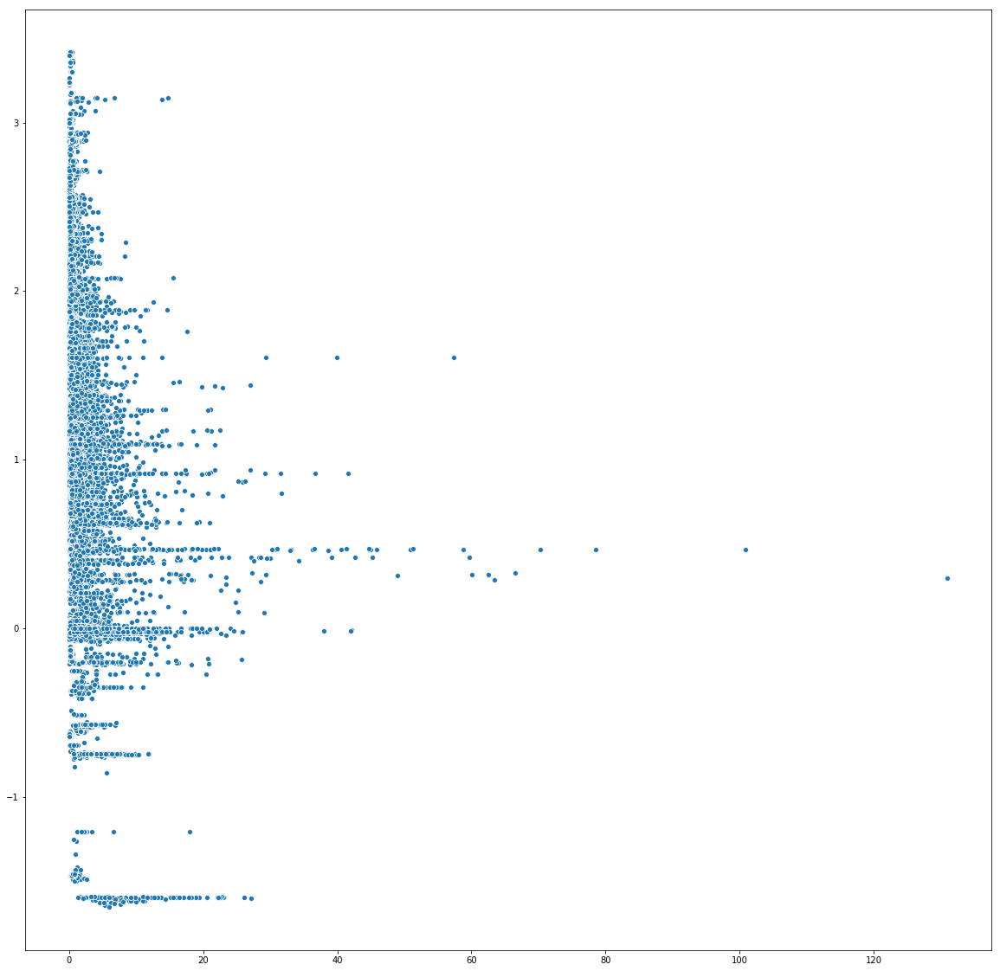

In [79]:
plt.figure(figsize=(20,20))
sns.scatterplot(mean, price_mean)

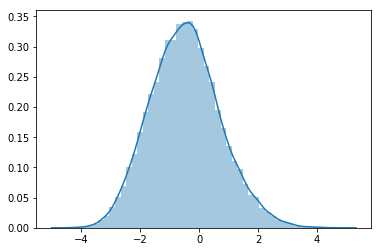

In [80]:
sns.distplot(np.log(mean))

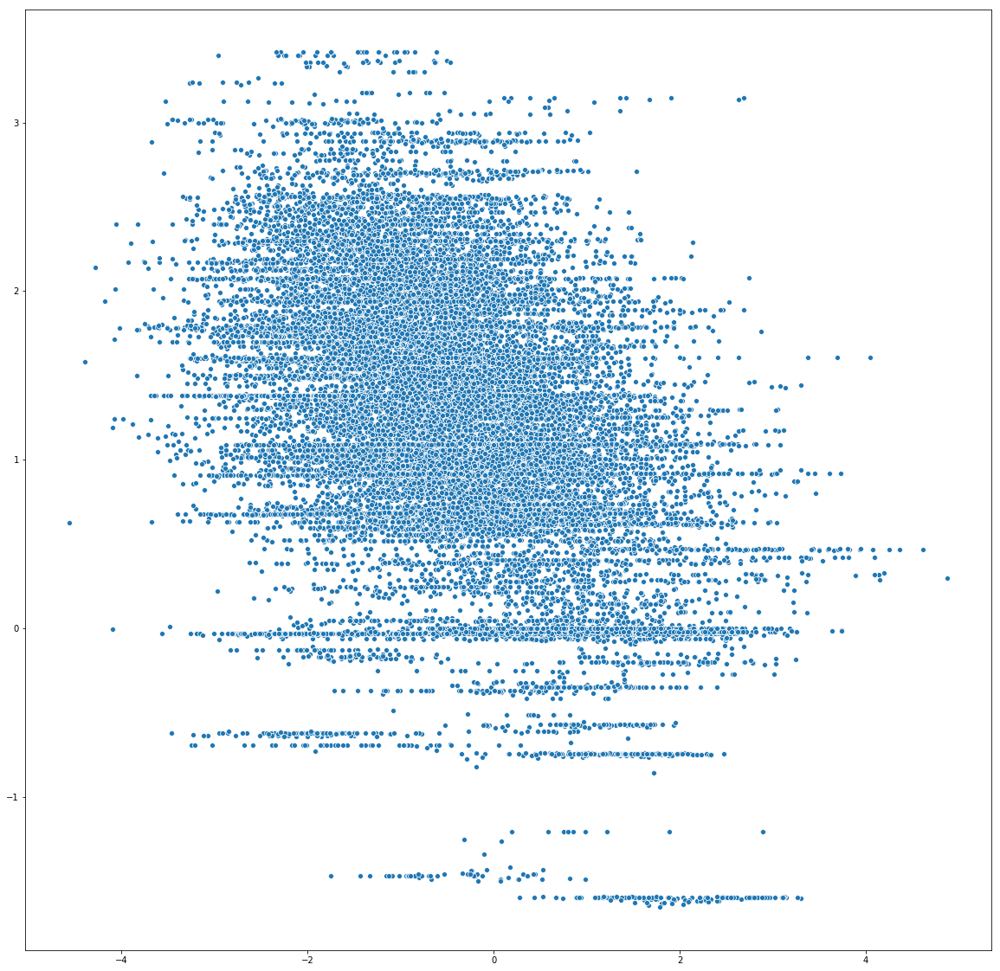

In [81]:
plt.figure(figsize=(20,20))
sns.scatterplot(np.log(mean), price_mean)

In [82]:
std  = np.log1p((is_sell.replace(0, np.nan).replace(1,0)[d_cols]+train_df[d_cols])).std(1)
mean  = np.log1p((is_sell.replace(0, np.nan).replace(1,0)[d_cols]+train_df[d_cols])).mean(1)

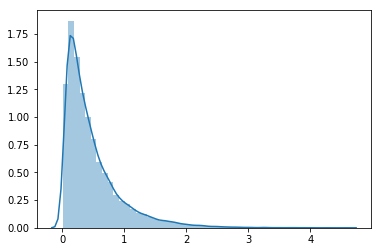

In [83]:
sns.distplot(mean)

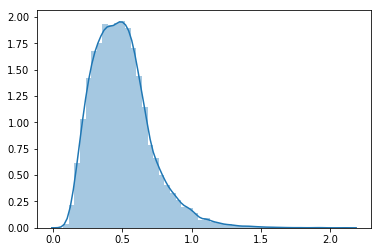

In [84]:
sns.distplot(std)

In [85]:
price_std = price_data.replace(0, np.nan).std(0)

In [89]:
price_std.mean(), price_std.std()

(0.13688384869444398, 0.22393711493625162)

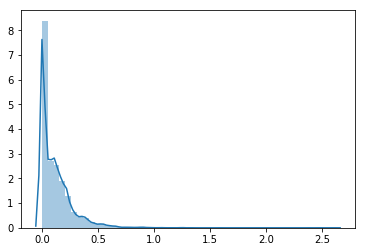

In [93]:
sns.distplot(np.log1p(price_std))

In [104]:
std  = (is_sell.replace(0, np.nan).replace(1,0)[d_cols]+train_df[d_cols]).std(1)
mean  = (is_sell.replace(0, np.nan).replace(1,0)[d_cols]+train_df[d_cols]).mean(1)
mean = np.log(mean)
price_mean = price_data.replace(0, np.nan).mean(0)
price_mean = np.log(price_mean)

In [103]:
item_id = train_df[train_df.dept_id=='FOODS_3'].id.unique()

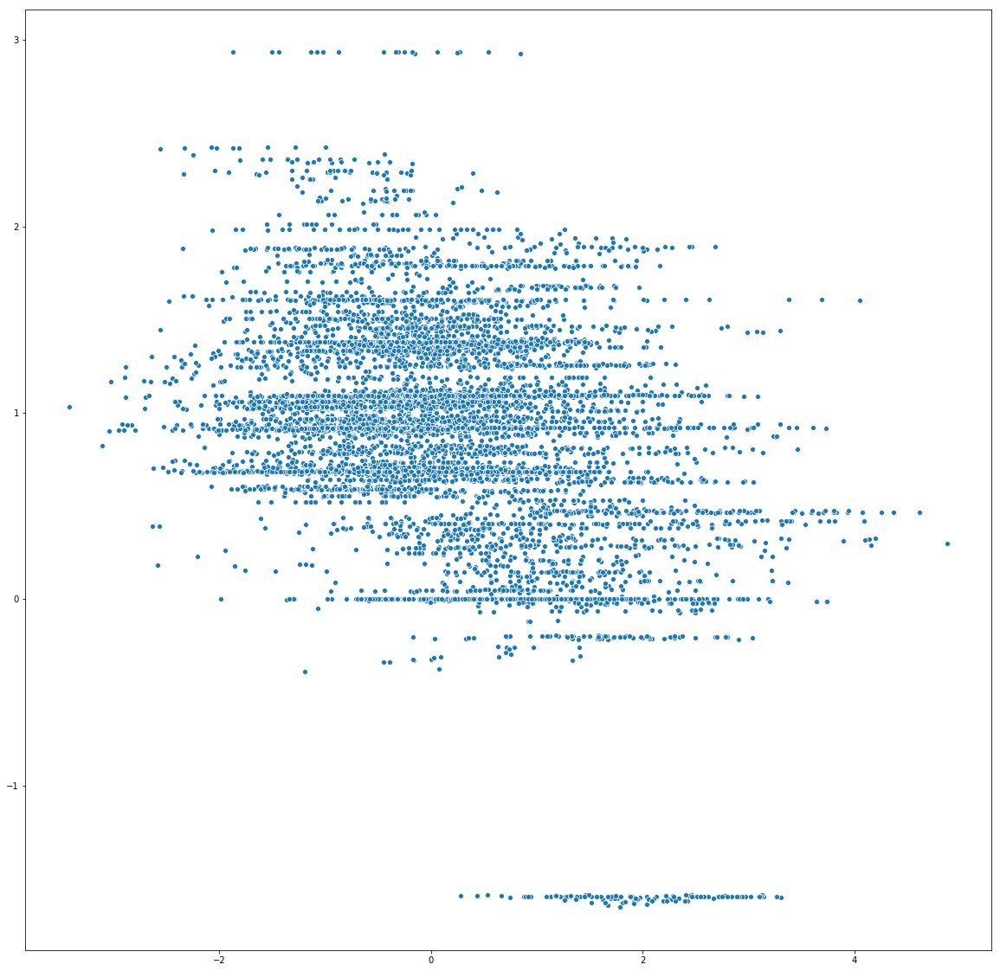

In [105]:
plt.figure(figsize=(20,20))
sns.scatterplot(mean[item_id], price_mean[item_id])

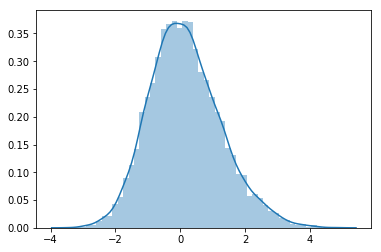

In [107]:
sns.distplot(mean[item_id])

In [ ]:
for i in range(1):
    plt.figure(figsize=(30,14))
    for m in range(2):
        for l in range(5):
            plt.subplot(2, 5, 5*m+l+1)
            sns.distplot(train_df.loc[item_id][d_cols].loc[item_id[i]])